# ***Import Data from Kaggel***

In [1]:
!mkdir ~/.kaggle/

In [8]:
!cp "/content/kaggle.json" ~/.kaggle/kaggle.json

In [9]:
!chmod 600 ~/.kaggle/kaggle.json

In [11]:
!python -m pip install -qq kaggle

In [12]:
!kaggle datasets download -d mohammednomer/semantic-segmentation

semantic-segmentation.zip: Skipping, found more recently modified local copy (use --force to force download)


In [13]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


In [14]:
!unzip semantic-segmentation -d data

Archive:  semantic-segmentation.zip
  inflating: data/About Acme AI.txt  
  inflating: data/COCO_Football Pixel.json  
  inflating: data/Frame 1  (1).jpg   
  inflating: data/Frame 1  (1).jpg___fuse.png  
  inflating: data/Frame 1  (1).jpg___save.png  
  inflating: data/Frame 1  (10).jpg  
  inflating: data/Frame 1  (10).jpg___fuse.png  
  inflating: data/Frame 1  (10).jpg___save.png  
  inflating: data/Frame 1  (100).jpg  
  inflating: data/Frame 1  (100).jpg___fuse.png  
  inflating: data/Frame 1  (100).jpg___save.png  
  inflating: data/Frame 1  (11).jpg  
  inflating: data/Frame 1  (11).jpg___fuse.png  
  inflating: data/Frame 1  (11).jpg___save.png  
  inflating: data/Frame 1  (12).jpg  
  inflating: data/Frame 1  (12).jpg___fuse.png  
  inflating: data/Frame 1  (12).jpg___save.png  
  inflating: data/Frame 1  (13).jpg  
  inflating: data/Frame 1  (13).jpg___fuse.png  
  inflating: data/Frame 1  (13).jpg___save.png  
  inflating: data/Frame 1  (14).jpg  
  inflating: data/Frame 1 

# ***Important Libraries***

In [32]:
import os
import keras
import numpy as np
import pandas as pd
import tensorflow as tf
from glob import glob
from tqdm import tqdm
import tensorflow.image as tfi
from tensorflow.keras.utils import load_img, img_to_array
import matplotlib.pyplot as plt
from keras.layers import add
from keras.layers import Input
from keras.layers import Layer
from keras.layers import Conv2D
from keras.layers import multiply
from keras.layers import Dropout
from keras.layers import MaxPool2D
from keras.layers import Concatenate
from keras.layers import Conv2DTranspose
from keras.layers import BatchNormalization
from keras.callbacks import Callback, ModelCheckpoint,EarlyStopping
from keras.models import Model
from tensorflow.keras.utils import plot_model

# ***Data Preprocessing***

In [16]:
path='/content/data/'
all_images = sorted(glob(path + "*.jpg"))
all_masks = sorted(glob(path + "*.jpg___fuse.png"))


In [17]:
all_images[0]

'/content/data/Frame 1  (1).jpg'

In [18]:
all_masks[0]

'/content/data/Frame 1  (1).jpg___fuse.png'

In [19]:
def load_image(path, SIZE=256):
    img = load_img(path)
    img = tfi.resize(img, (SIZE, SIZE))
    img = img_to_array(img)
    img = tf.cast(img, tf.float32)
    img = img/255.
    return img

def load_data(image_paths, label_paths, SIZE=256):
    images, label_maps = np.zeros(shape=(len(image_paths), SIZE, SIZE, 3)), np.zeros(shape=(len(label_paths), SIZE, SIZE, 3))
    for i, (image_path, label_path) in tqdm(enumerate(zip(image_paths, label_paths)), desc="Loading"):
        image, label_map = load_image(image_path, SIZE=SIZE), load_image(label_path, SIZE=SIZE)
        images[i], label_maps[i] = image, label_map
    return images, label_maps

In [20]:
images, labels = load_data(all_images, all_masks)

Loading: 100it [00:11,  8.70it/s]


# ***Data Visualization***

In [21]:
def show_map(image, label_map, alpha_1=1, alpha_2=0.7):
    plt.imshow(image, alpha=alpha_1)
    plt.imshow(label_map, alpha=alpha_2)
    plt.axis('off')

In [63]:
def show_maps(images, label_maps, GRID=[5,6], SIZE=(25,25)):

    n_rows, n_cols = GRID
    n_images = n_rows * n_cols
    plt.figure(figsize=SIZE)

    i=1
    for image, label_map in zip(images, label_maps):


        plt.subplot(n_rows, n_cols, i)
        show_map(image, label_map)

        i+=1
        if i>n_images:
            break


    plt.show()

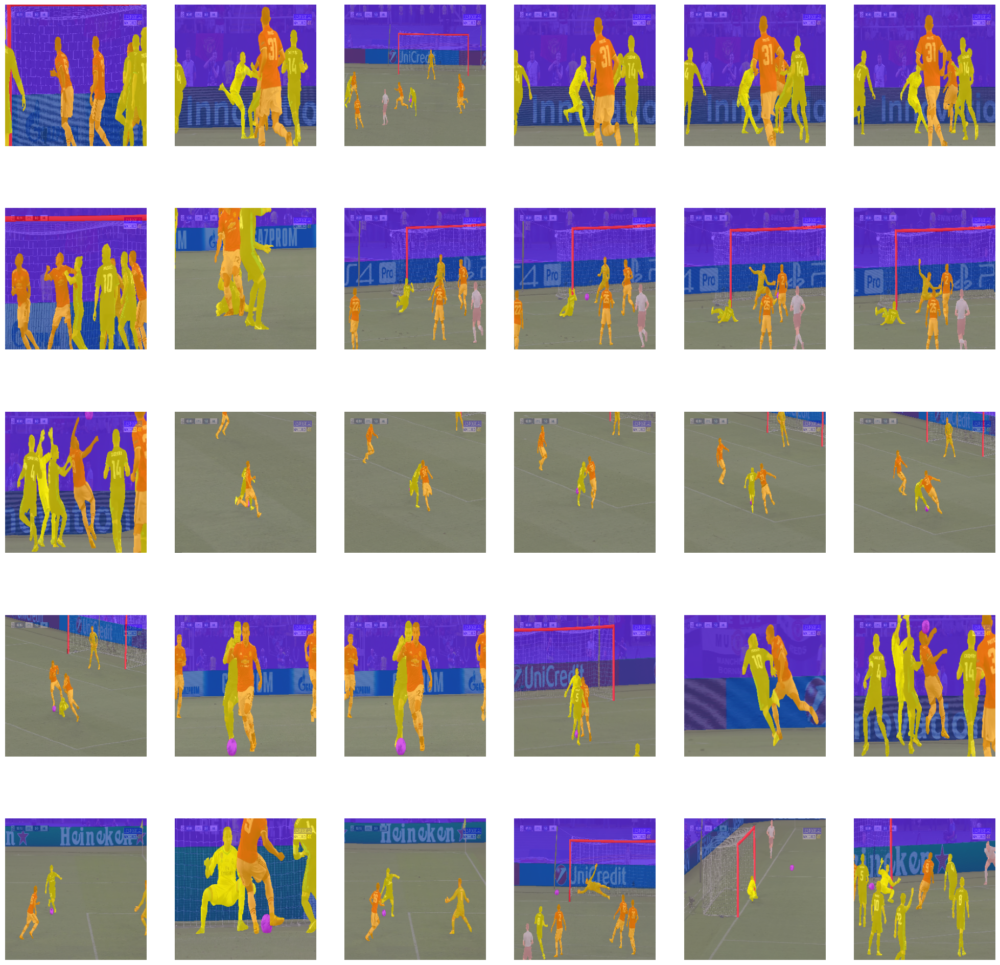

In [23]:
show_maps(images, labels)

In [24]:
def show_image(image, title=None):
    plt.imshow(image)
    plt.title(title)
    plt.axis('off')

In [25]:
class ShowProgress(Callback):
    def on_epoch_end(self, epoch, logs=None):
        id = np.random.randint(len(images))
        image = images[id]
        mask = labels[id]
        pred_mask = self.model(tf.expand_dims(image,axis=0))[0]

        plt.figure(figsize=(10,8))
        plt.subplot(1,3,1)
        show_image(image, title="Original Image")

        plt.subplot(1,3,2)
        show_image(mask, title="Original Mask")

        plt.subplot(1,3,3)
        show_image(pred_mask, title="Predicted Mask")

        plt.tight_layout()
        plt.show()

# ***UNet Model***

In [26]:
import tensorflow as tf
from tensorflow.keras import layers, Model
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Encoder Block
def encoder_block(x, filters, rate=0.2, pooling=True):
    x = layers.BatchNormalization()(x)
    x = layers.Conv2D(filters, kernel_size=3, strides=1, padding='same', activation='relu', kernel_initializer='he_normal')(x)
    x = layers.Dropout(rate)(x)
    x = layers.Conv2D(filters, kernel_size=3, strides=1, padding='same', activation='relu', kernel_initializer='he_normal')(x)
    if pooling:
        y = layers.MaxPool2D()(x)
        return x, y
    return x

# Decoder Block
def decoder_block(x, skip_x, filters, rate):
    y = layers.Conv2DTranspose(filters, kernel_size=3, strides=2, padding='same', activation='relu', kernel_initializer='he_normal')(x)
    y = layers.BatchNormalization()(y)
    y = layers.Concatenate()([y, skip_x])
    y = encoder_block(y, filters, rate, pooling=False)
    return y


In [27]:
# Input Layer
input_layer = layers.Input(shape=(256, 256, 3), name="InputImage")

# Encoder Blocks
c1, p1 = encoder_block(input_layer, filters=64, rate=0.1)
c2, p2 = encoder_block(p1, filters=128, rate=0.1)
c3, p3 = encoder_block(p2, filters=256, rate=0.2)
c4, p4 = encoder_block(p3, filters=512, rate=0.2)

# Encoding Layer
encodings = encoder_block(p4, filters=512, rate=0.3, pooling=False)

# Decoder Blocks
d = decoder_block(encodings, c4, filters=512, rate=0.2)
d = decoder_block(d, c3, filters=256, rate=0.2)
d = decoder_block(d, c2, filters=128, rate=0.1)
d = decoder_block(d, c1, filters=64, rate=0.1)

# Output
conv_out = layers.Conv2D(3, kernel_size=3, padding='same', activation='sigmoid', name="Segmentator")(d)

model = Model(input_layer, conv_out, name="UNet")
model.summary()


Model: "UNet"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 InputImage (InputLayer)     [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 batch_normalization (Batch  (None, 256, 256, 3)          12        ['InputImage[0][0]']          
 Normalization)                                                                                   
                                                                                                  
 conv2d (Conv2D)             (None, 256, 256, 64)         1792      ['batch_normalization[0][0]'] 
                                                                                                  
 dropout (Dropout)           (None, 256, 256, 64)         0         ['conv2d[0][0]']           

# ***UNet Model Visualization***

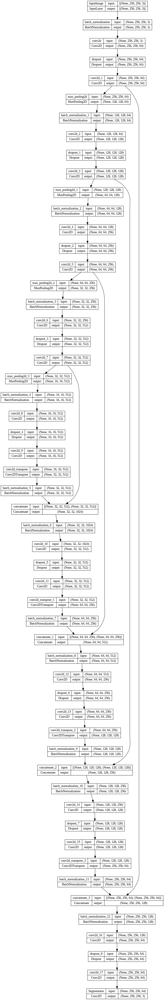

In [28]:
plot_model(model, "UNet.png", show_shapes=True)

# ***Training***

In [30]:
BATCH_SIZE = 16
SPE = len(images)//BATCH_SIZE

In [36]:
early_stopping = EarlyStopping(monitor='val_accuracy', patience=10, restore_best_weights=True)

In [37]:
cbs = [ModelCheckpoint("UNet-Footbal-Player-Segmentation.h5", save_best_only=True),ShowProgress(),early_stopping]

Epoch 1/200
6/6 [==============================] - ETA: 0s - loss: 0.7662 - accuracy: 0.4733

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


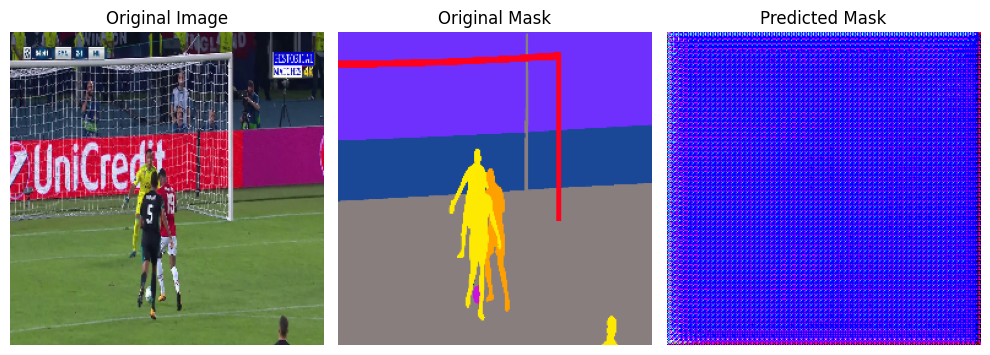

6/6 [==============================] - 65s 3s/step - loss: 0.7662 - accuracy: 0.4733 - val_loss: 526.4105 - val_accuracy: 0.4816
Epoch 2/200
6/6 [==============================] - ETA: 0s - loss: 0.6827 - accuracy: 0.5930

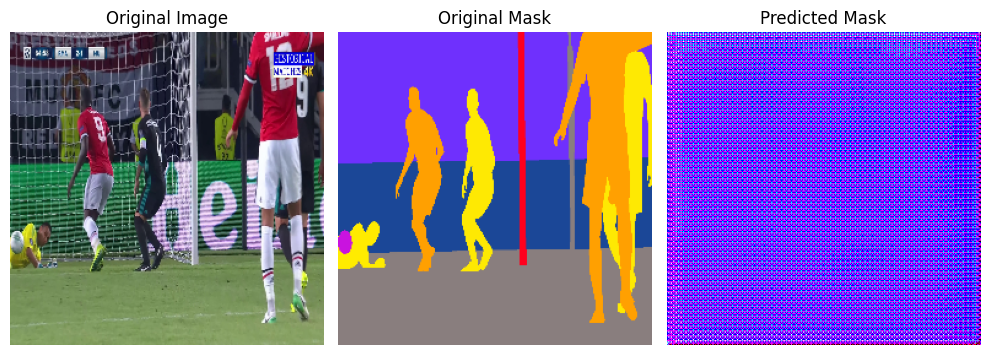

6/6 [==============================] - 9s 2s/step - loss: 0.6827 - accuracy: 0.5930 - val_loss: 354.2854 - val_accuracy: 0.4837
Epoch 3/200
6/6 [==============================] - ETA: 0s - loss: 0.6609 - accuracy: 0.6327

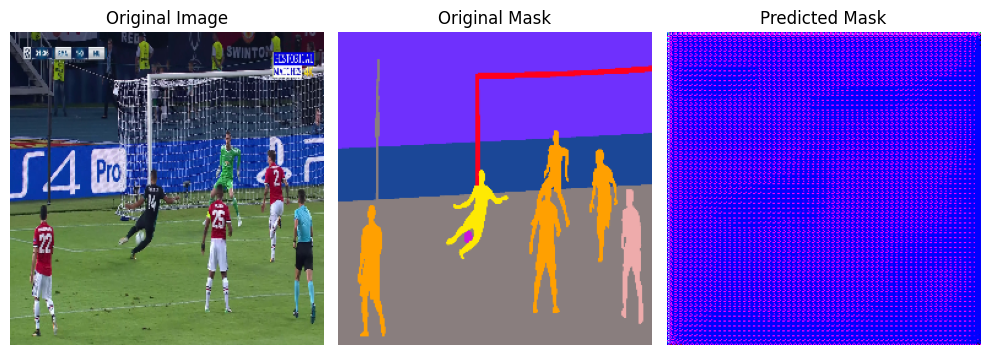

6/6 [==============================] - 9s 1s/step - loss: 0.6609 - accuracy: 0.6327 - val_loss: 149.9317 - val_accuracy: 0.4794
Epoch 4/200
6/6 [==============================] - ETA: 0s - loss: 0.6464 - accuracy: 0.7185

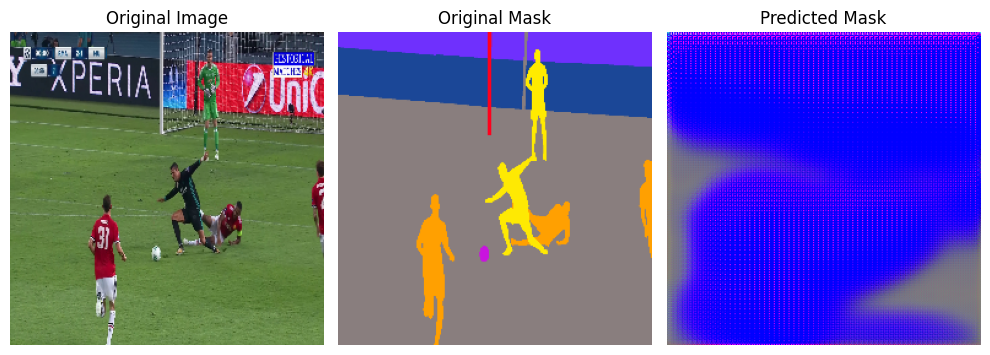

6/6 [==============================] - 8s 1s/step - loss: 0.6464 - accuracy: 0.7185 - val_loss: 23.0021 - val_accuracy: 0.4850
Epoch 5/200
6/6 [==============================] - ETA: 0s - loss: 0.6312 - accuracy: 0.7539

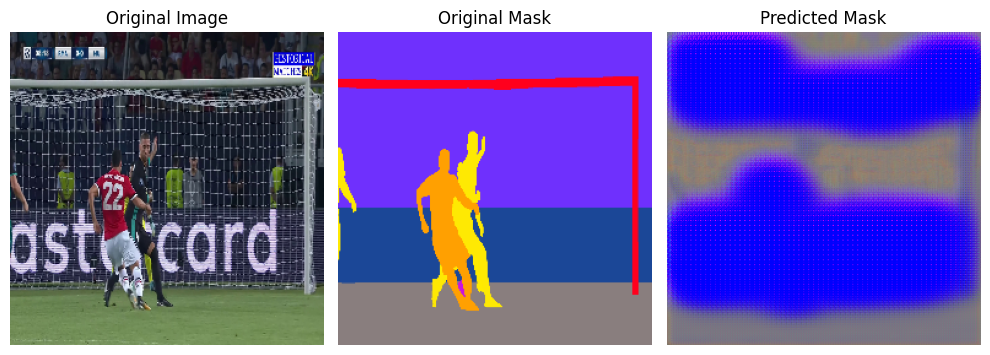

6/6 [==============================] - 9s 2s/step - loss: 0.6312 - accuracy: 0.7539 - val_loss: 1.9132 - val_accuracy: 0.6027
Epoch 6/200
6/6 [==============================] - ETA: 0s - loss: 0.6145 - accuracy: 0.7291

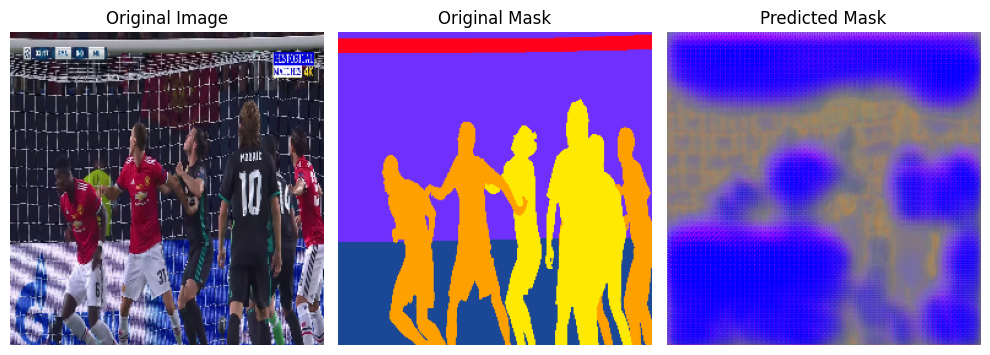

6/6 [==============================] - 8s 1s/step - loss: 0.6145 - accuracy: 0.7291 - val_loss: 1.0497 - val_accuracy: 0.7138
Epoch 7/200
6/6 [==============================] - ETA: 0s - loss: 0.5981 - accuracy: 0.7931

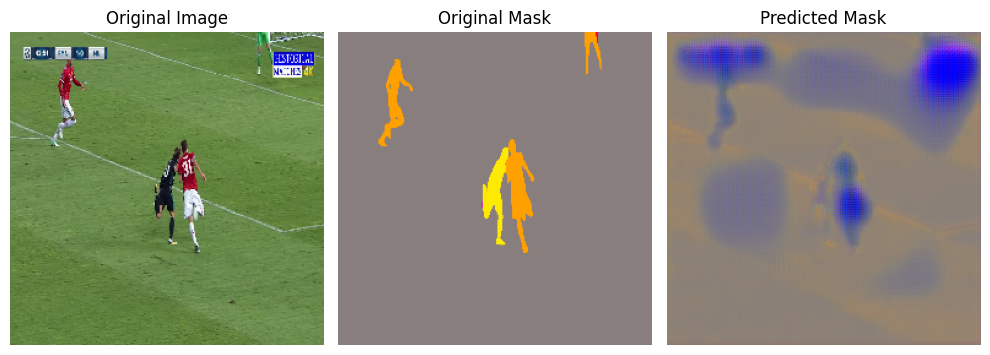

6/6 [==============================] - 9s 1s/step - loss: 0.5981 - accuracy: 0.7931 - val_loss: 0.7457 - val_accuracy: 0.7774
Epoch 8/200
6/6 [==============================] - ETA: 0s - loss: 0.6120 - accuracy: 0.7603

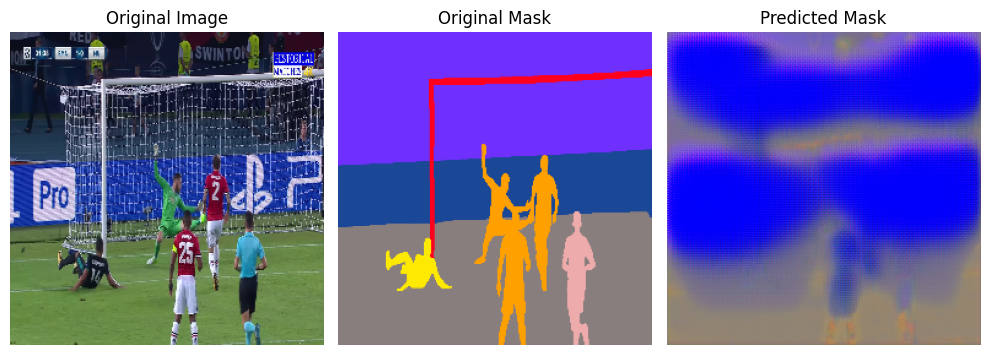

6/6 [==============================] - 8s 1s/step - loss: 0.6120 - accuracy: 0.7603 - val_loss: 1.0790 - val_accuracy: 0.6116
Epoch 9/200
6/6 [==============================] - ETA: 0s - loss: 0.5881 - accuracy: 0.7704

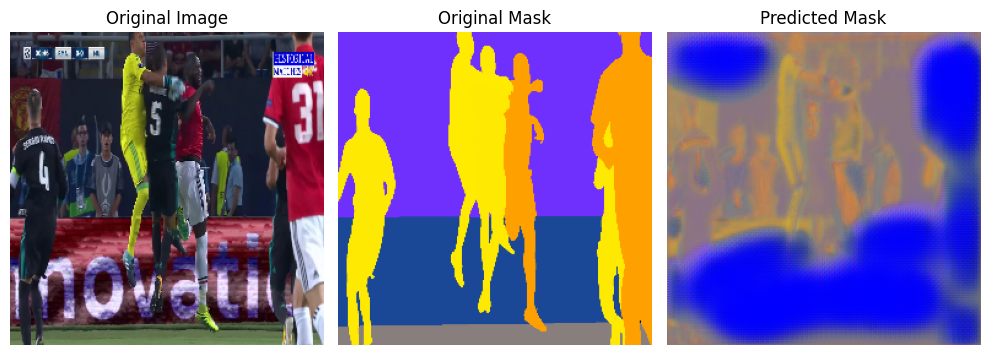

6/6 [==============================] - 8s 1s/step - loss: 0.5881 - accuracy: 0.7704 - val_loss: 0.9048 - val_accuracy: 0.7125
Epoch 10/200
6/6 [==============================] - ETA: 0s - loss: 0.5763 - accuracy: 0.8107

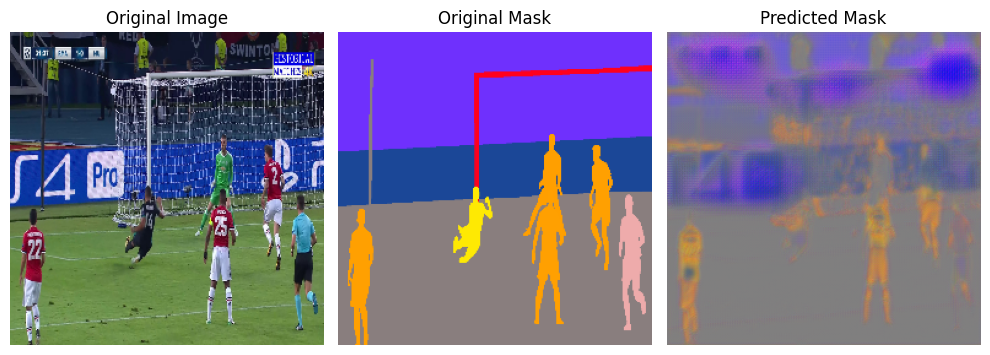

6/6 [==============================] - 9s 2s/step - loss: 0.5763 - accuracy: 0.8107 - val_loss: 0.6544 - val_accuracy: 0.7780
Epoch 11/200
6/6 [==============================] - ETA: 0s - loss: 0.5654 - accuracy: 0.8280

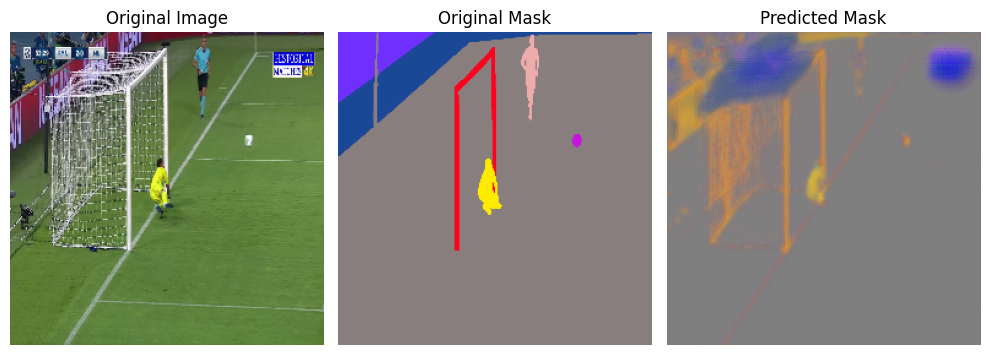

6/6 [==============================] - 8s 1s/step - loss: 0.5654 - accuracy: 0.8280 - val_loss: 0.6651 - val_accuracy: 0.7818
Epoch 12/200
6/6 [==============================] - ETA: 0s - loss: 0.5677 - accuracy: 0.8401

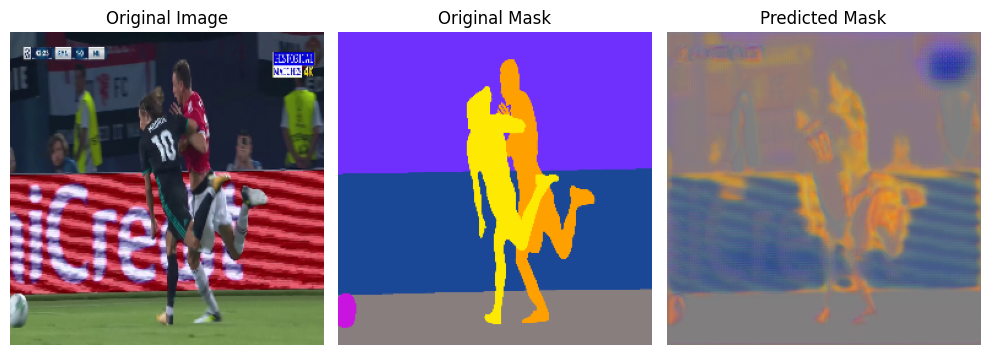

6/6 [==============================] - 8s 1s/step - loss: 0.5677 - accuracy: 0.8401 - val_loss: 0.6544 - val_accuracy: 0.7549
Epoch 13/200
6/6 [==============================] - ETA: 0s - loss: 0.5651 - accuracy: 0.8426

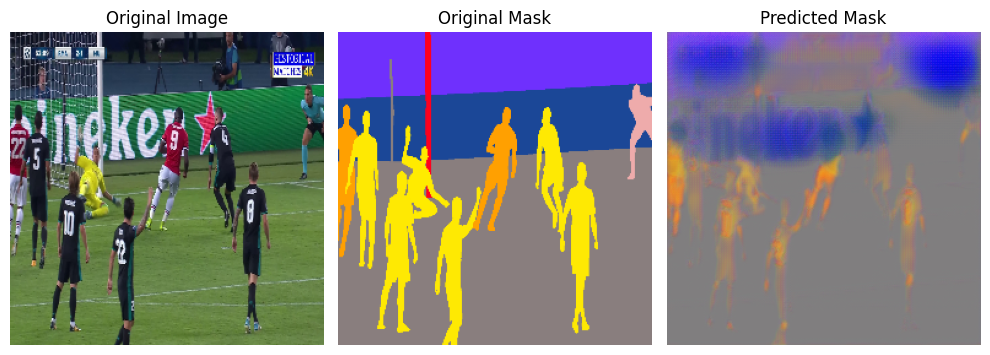

6/6 [==============================] - 10s 2s/step - loss: 0.5651 - accuracy: 0.8426 - val_loss: 0.6412 - val_accuracy: 0.8455
Epoch 14/200
6/6 [==============================] - ETA: 0s - loss: 0.5871 - accuracy: 0.7946

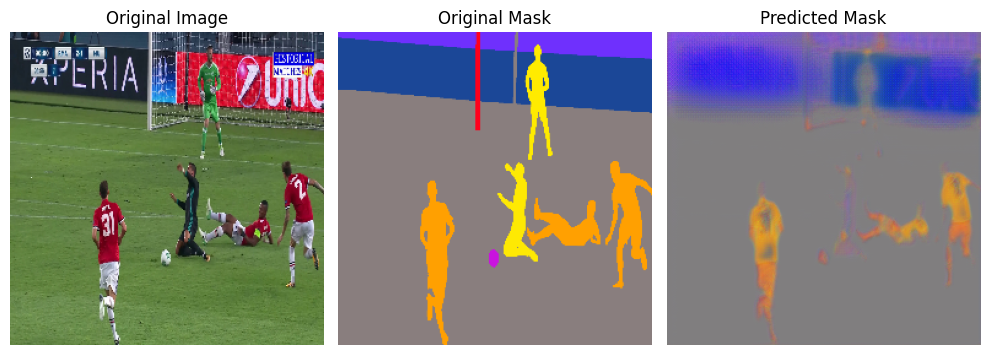

6/6 [==============================] - 8s 1s/step - loss: 0.5871 - accuracy: 0.7946 - val_loss: 0.6491 - val_accuracy: 0.8123
Epoch 15/200
6/6 [==============================] - ETA: 0s - loss: 0.5635 - accuracy: 0.8493

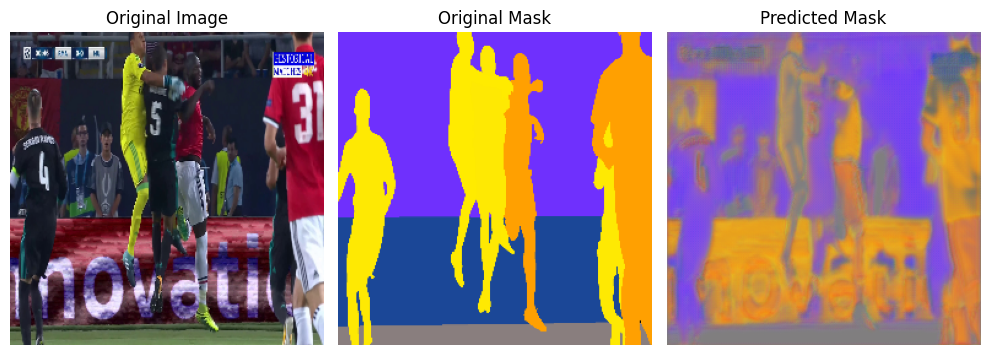

6/6 [==============================] - 9s 2s/step - loss: 0.5635 - accuracy: 0.8493 - val_loss: 0.6232 - val_accuracy: 0.8544
Epoch 16/200
6/6 [==============================] - ETA: 0s - loss: 0.5557 - accuracy: 0.8436

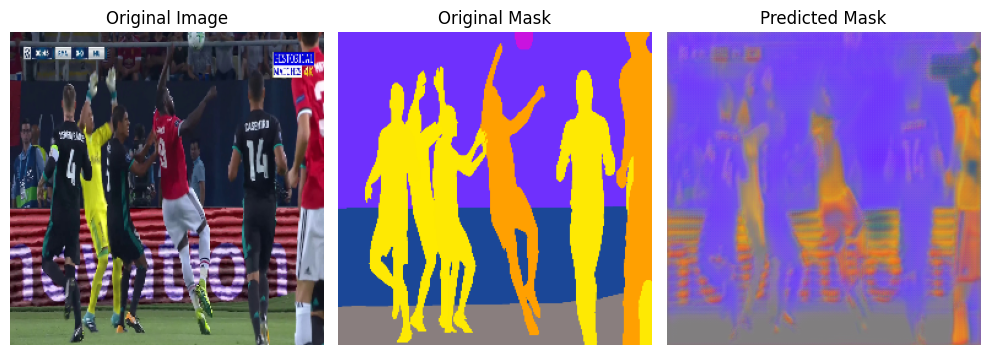

6/6 [==============================] - 8s 1s/step - loss: 0.5557 - accuracy: 0.8436 - val_loss: 0.6426 - val_accuracy: 0.7382
Epoch 17/200
6/6 [==============================] - ETA: 0s - loss: 0.5556 - accuracy: 0.8759

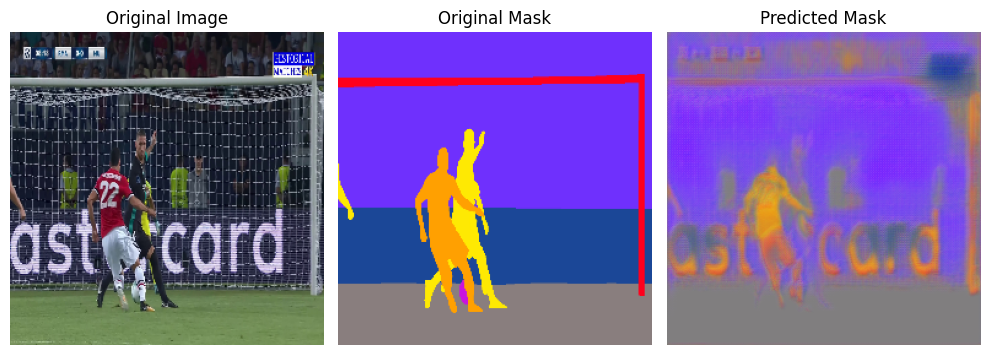

6/6 [==============================] - 8s 1s/step - loss: 0.5556 - accuracy: 0.8759 - val_loss: 0.6362 - val_accuracy: 0.8609
Epoch 18/200
6/6 [==============================] - ETA: 0s - loss: 0.5472 - accuracy: 0.8929

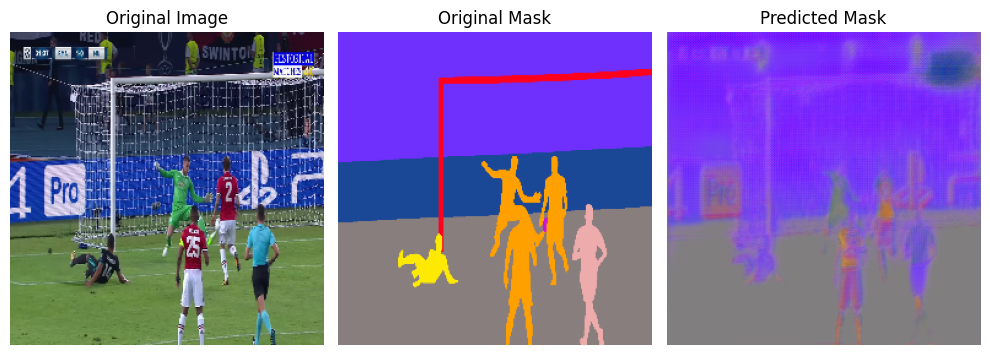

6/6 [==============================] - 8s 1s/step - loss: 0.5472 - accuracy: 0.8929 - val_loss: 0.6684 - val_accuracy: 0.8177
Epoch 19/200
6/6 [==============================] - ETA: 0s - loss: 0.5478 - accuracy: 0.9029

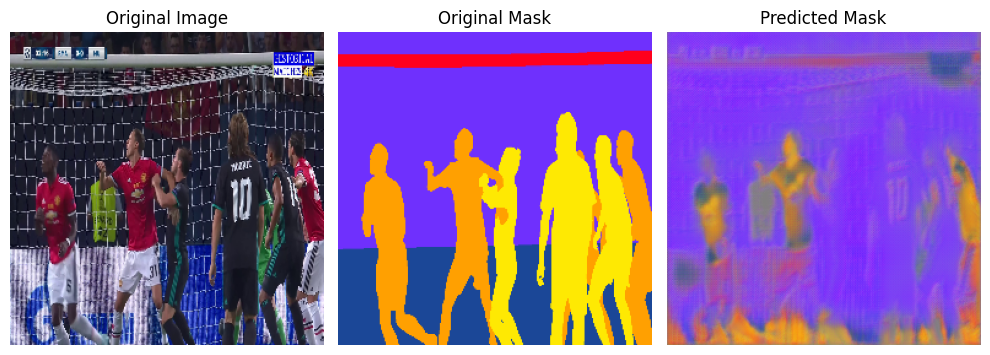

6/6 [==============================] - 8s 1s/step - loss: 0.5478 - accuracy: 0.9029 - val_loss: 0.6505 - val_accuracy: 0.8608
Epoch 20/200
6/6 [==============================] - ETA: 0s - loss: 0.5405 - accuracy: 0.9189

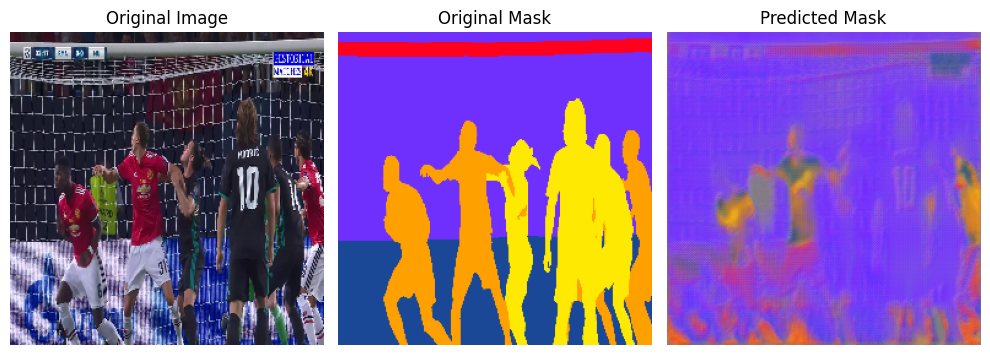

6/6 [==============================] - 8s 1s/step - loss: 0.5405 - accuracy: 0.9189 - val_loss: 0.6523 - val_accuracy: 0.8432
Epoch 21/200
6/6 [==============================] - ETA: 0s - loss: 0.5494 - accuracy: 0.9160

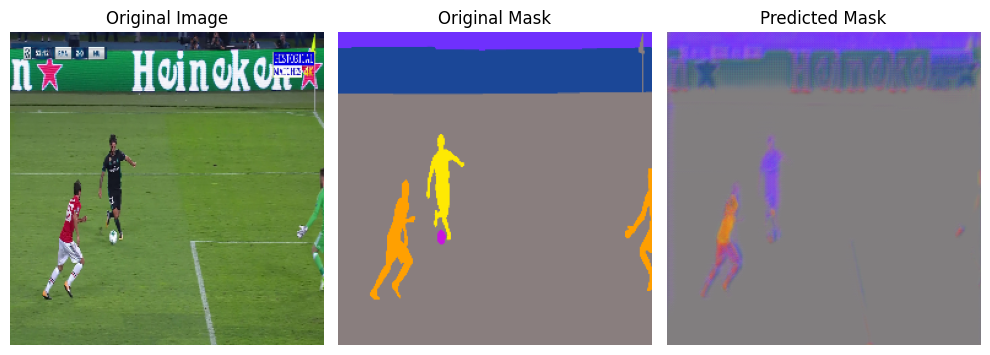

6/6 [==============================] - 8s 1s/step - loss: 0.5494 - accuracy: 0.9160 - val_loss: 0.6614 - val_accuracy: 0.8198
Epoch 22/200
6/6 [==============================] - ETA: 0s - loss: 0.5350 - accuracy: 0.9224

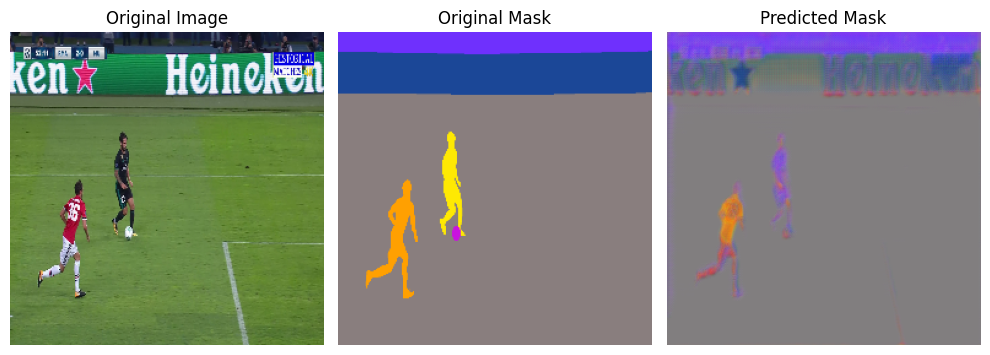

6/6 [==============================] - 8s 1s/step - loss: 0.5350 - accuracy: 0.9224 - val_loss: 0.6414 - val_accuracy: 0.8317
Epoch 23/200
6/6 [==============================] - ETA: 0s - loss: 0.5349 - accuracy: 0.9287

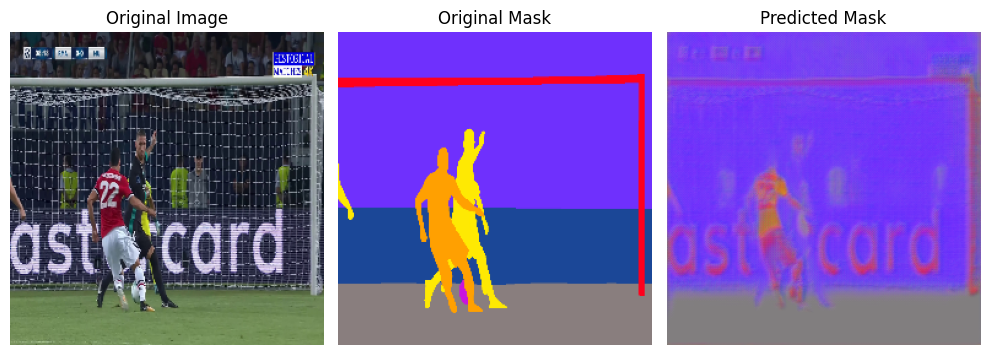

6/6 [==============================] - 8s 1s/step - loss: 0.5349 - accuracy: 0.9287 - val_loss: 0.6569 - val_accuracy: 0.8359
Epoch 24/200
6/6 [==============================] - ETA: 0s - loss: 0.5358 - accuracy: 0.9307

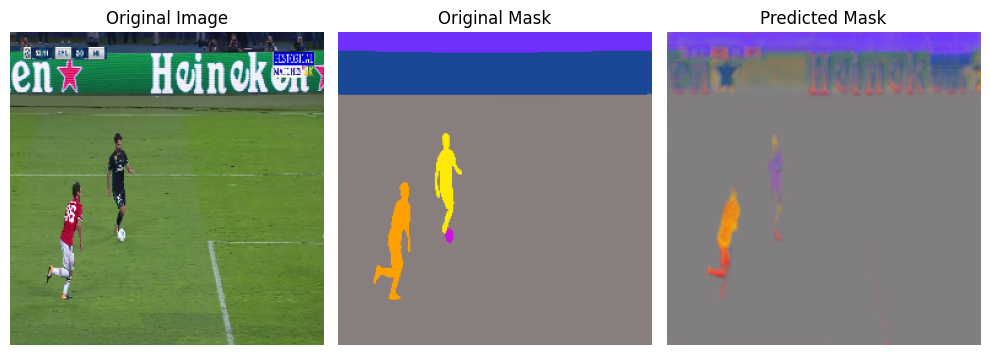

6/6 [==============================] - 8s 1s/step - loss: 0.5358 - accuracy: 0.9307 - val_loss: 0.6357 - val_accuracy: 0.8662
Epoch 25/200
6/6 [==============================] - ETA: 0s - loss: 0.5301 - accuracy: 0.9416

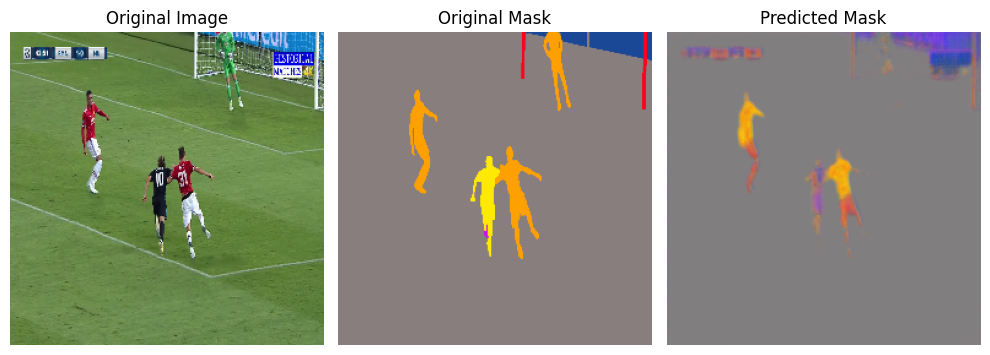

6/6 [==============================] - 9s 1s/step - loss: 0.5301 - accuracy: 0.9416 - val_loss: 0.6440 - val_accuracy: 0.8634
Epoch 26/200
6/6 [==============================] - ETA: 0s - loss: 0.5399 - accuracy: 0.9231

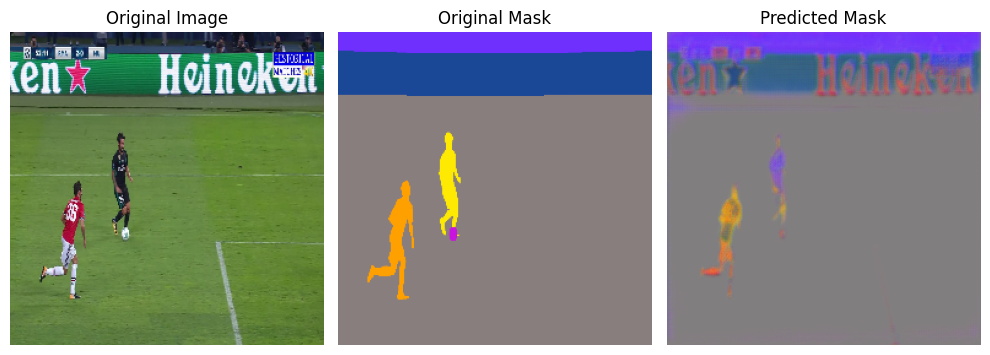

6/6 [==============================] - 8s 1s/step - loss: 0.5399 - accuracy: 0.9231 - val_loss: 0.6658 - val_accuracy: 0.8206
Epoch 27/200
6/6 [==============================] - ETA: 0s - loss: 0.5346 - accuracy: 0.9305

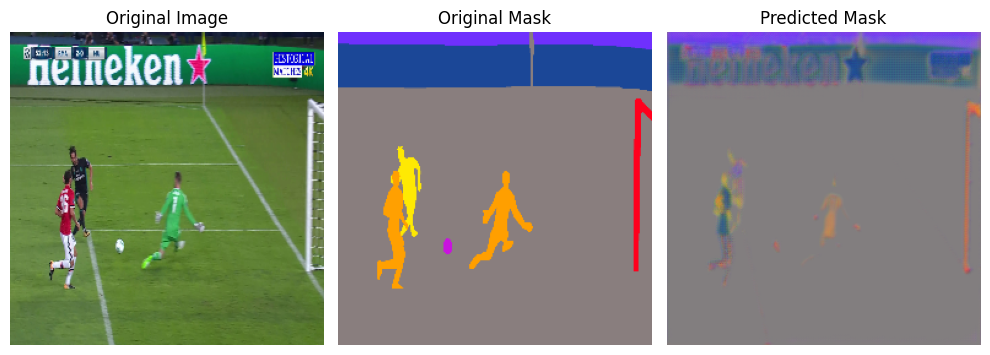

6/6 [==============================] - 9s 2s/step - loss: 0.5346 - accuracy: 0.9305 - val_loss: 0.6358 - val_accuracy: 0.8706
Epoch 28/200
6/6 [==============================] - ETA: 0s - loss: 0.5213 - accuracy: 0.9389

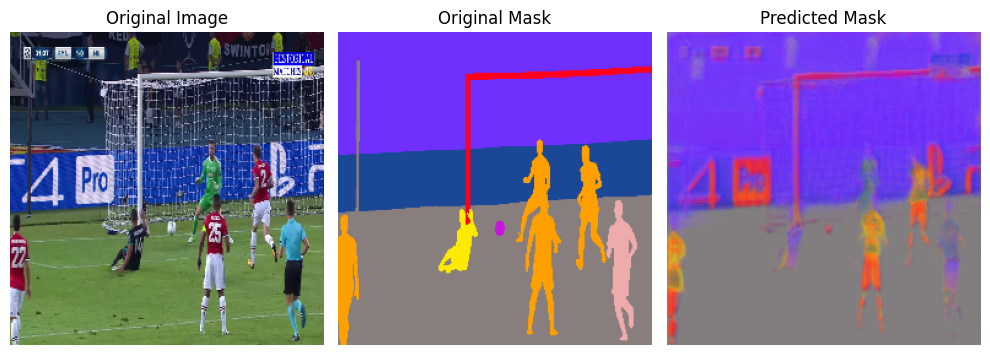

6/6 [==============================] - 8s 1s/step - loss: 0.5213 - accuracy: 0.9389 - val_loss: 0.6350 - val_accuracy: 0.8715
Epoch 29/200
6/6 [==============================] - ETA: 0s - loss: 0.5273 - accuracy: 0.9474

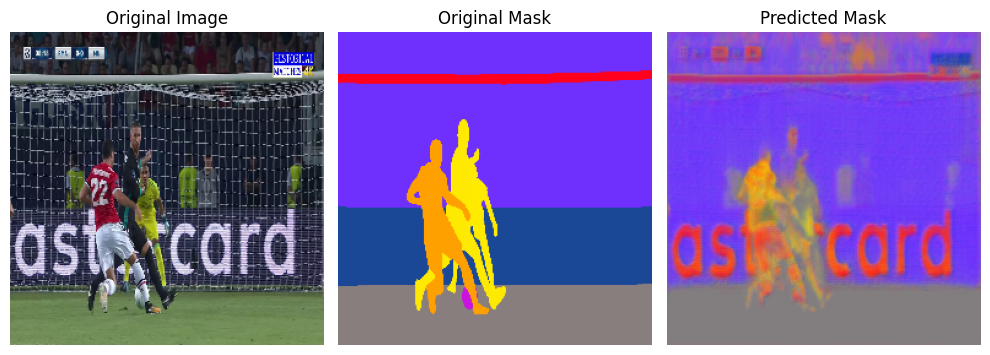

6/6 [==============================] - 8s 1s/step - loss: 0.5273 - accuracy: 0.9474 - val_loss: 0.6313 - val_accuracy: 0.8759
Epoch 30/200
6/6 [==============================] - ETA: 0s - loss: 0.5275 - accuracy: 0.9472

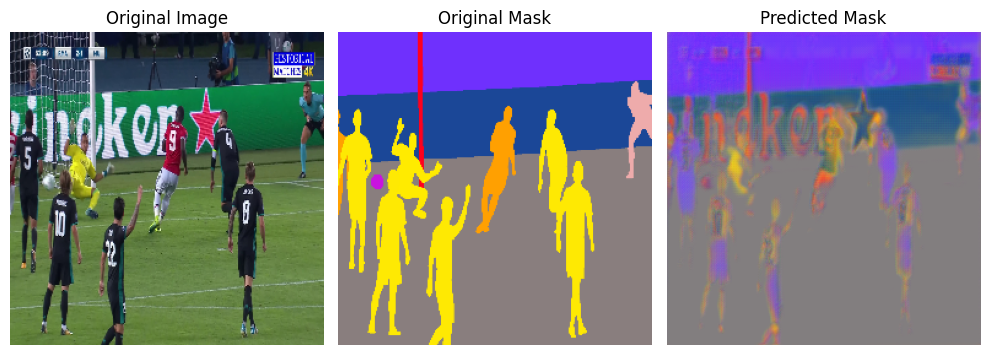

6/6 [==============================] - 8s 1s/step - loss: 0.5275 - accuracy: 0.9472 - val_loss: 0.6401 - val_accuracy: 0.8756
Epoch 31/200
6/6 [==============================] - ETA: 0s - loss: 0.5214 - accuracy: 0.9513

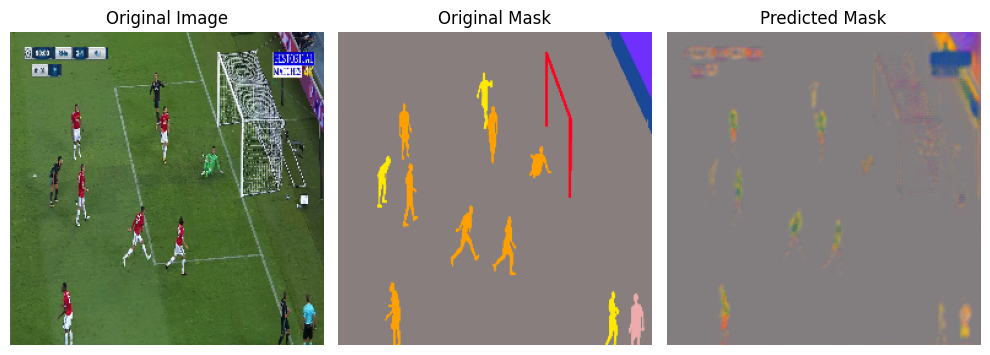

6/6 [==============================] - 8s 1s/step - loss: 0.5214 - accuracy: 0.9513 - val_loss: 0.6312 - val_accuracy: 0.8681
Epoch 32/200
6/6 [==============================] - ETA: 0s - loss: 0.5328 - accuracy: 0.9477

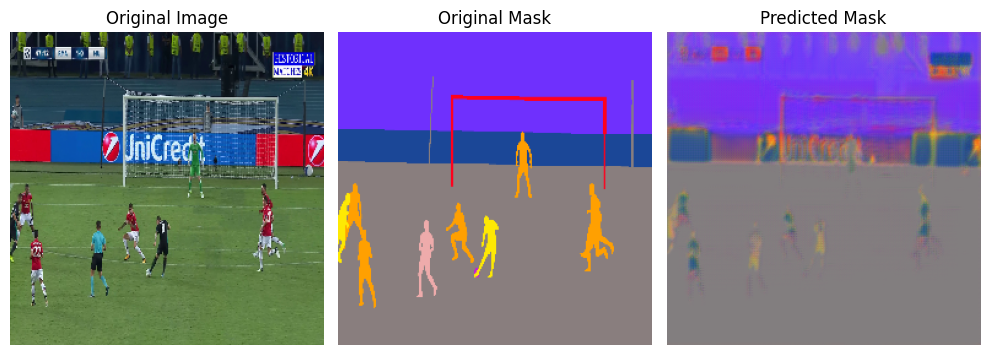

6/6 [==============================] - 8s 1s/step - loss: 0.5328 - accuracy: 0.9477 - val_loss: 0.6354 - val_accuracy: 0.8575
Epoch 33/200
6/6 [==============================] - ETA: 0s - loss: 0.5232 - accuracy: 0.9533

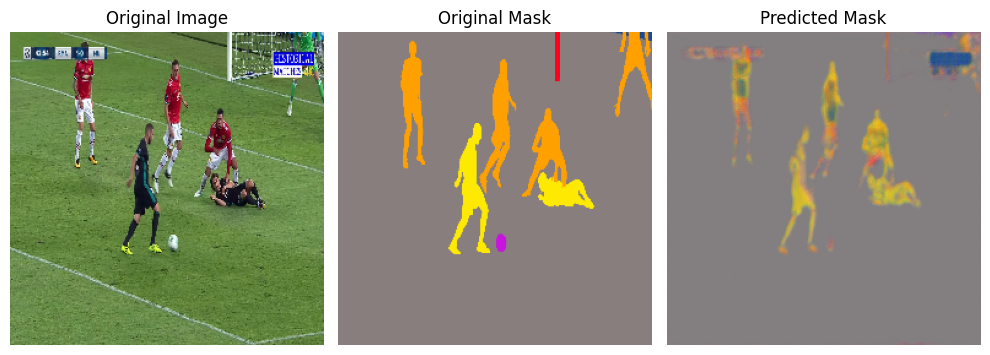

6/6 [==============================] - 8s 1s/step - loss: 0.5232 - accuracy: 0.9533 - val_loss: 0.6324 - val_accuracy: 0.8607
Epoch 34/200
6/6 [==============================] - ETA: 0s - loss: 0.5200 - accuracy: 0.9574

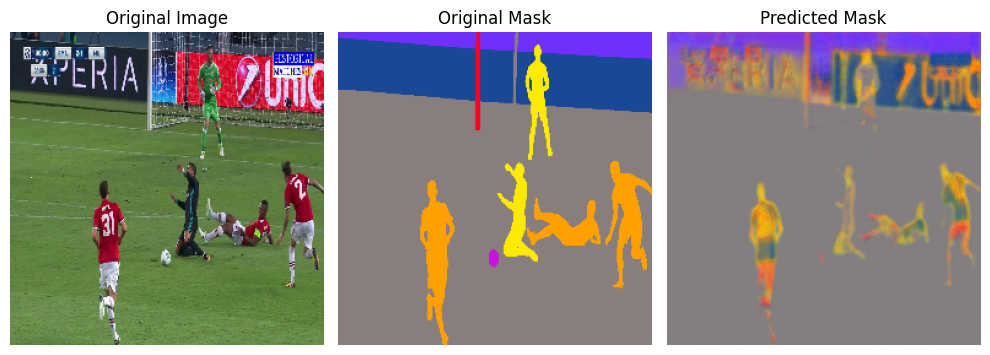

6/6 [==============================] - 9s 1s/step - loss: 0.5200 - accuracy: 0.9574 - val_loss: 0.6343 - val_accuracy: 0.8671
Epoch 35/200
6/6 [==============================] - ETA: 0s - loss: 0.5296 - accuracy: 0.9521

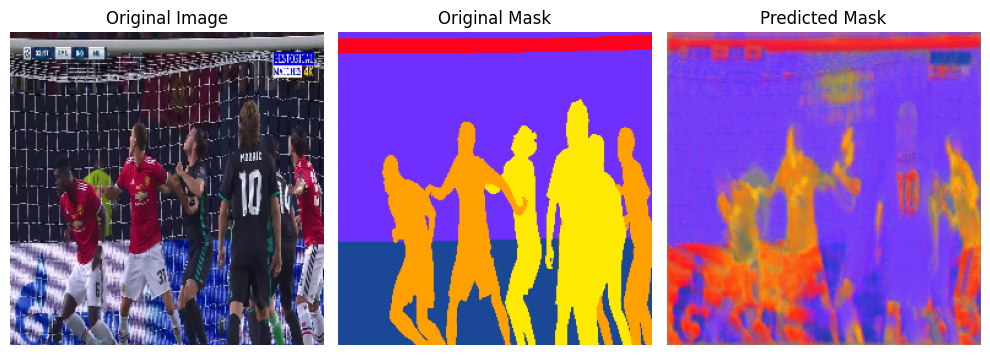

6/6 [==============================] - 8s 1s/step - loss: 0.5296 - accuracy: 0.9521 - val_loss: 0.6327 - val_accuracy: 0.8805
Epoch 36/200
6/6 [==============================] - ETA: 0s - loss: 0.5304 - accuracy: 0.9558

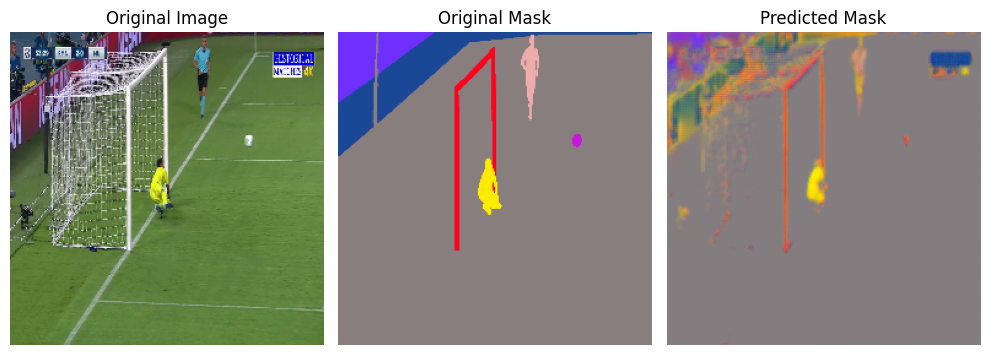

6/6 [==============================] - 8s 1s/step - loss: 0.5304 - accuracy: 0.9558 - val_loss: 0.6378 - val_accuracy: 0.8499
Epoch 37/200
6/6 [==============================] - ETA: 0s - loss: 0.5180 - accuracy: 0.9608

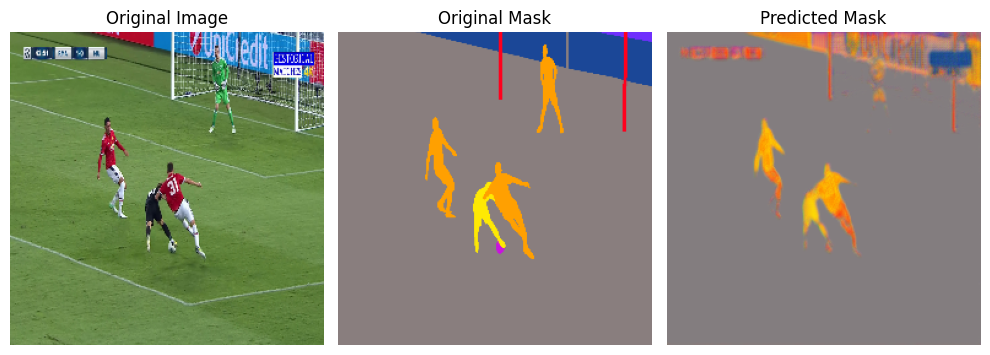

6/6 [==============================] - 8s 1s/step - loss: 0.5180 - accuracy: 0.9608 - val_loss: 0.6382 - val_accuracy: 0.8525
Epoch 38/200
6/6 [==============================] - ETA: 0s - loss: 0.5196 - accuracy: 0.9642

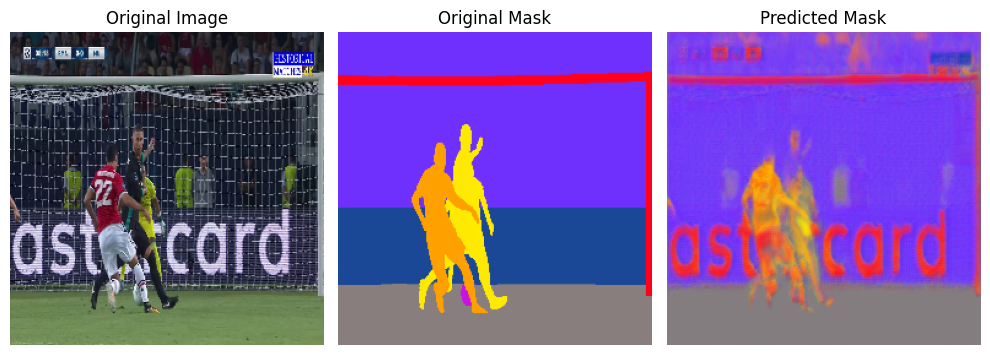

6/6 [==============================] - 8s 1s/step - loss: 0.5196 - accuracy: 0.9642 - val_loss: 0.6308 - val_accuracy: 0.8805
Epoch 39/200
6/6 [==============================] - ETA: 0s - loss: 0.5334 - accuracy: 0.9608

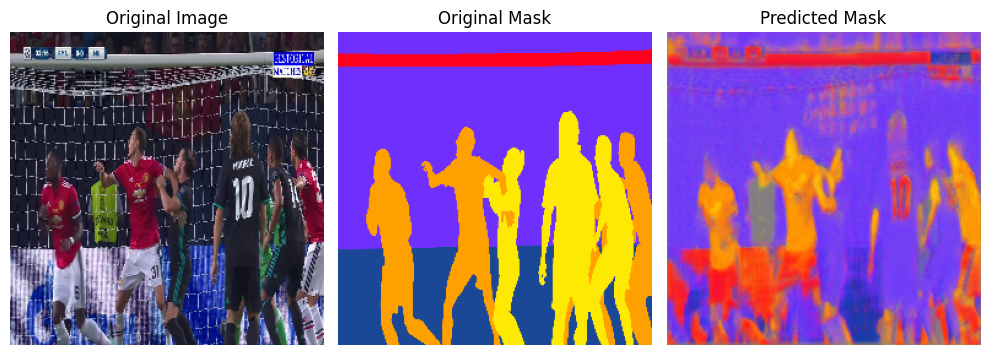

6/6 [==============================] - 8s 1s/step - loss: 0.5334 - accuracy: 0.9608 - val_loss: 0.6375 - val_accuracy: 0.8725
Epoch 40/200
6/6 [==============================] - ETA: 0s - loss: 0.5162 - accuracy: 0.9630

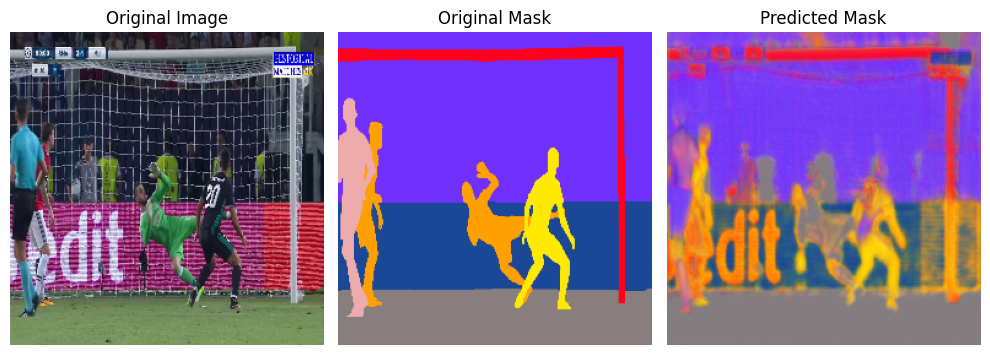

6/6 [==============================] - 8s 1s/step - loss: 0.5162 - accuracy: 0.9630 - val_loss: 0.6417 - val_accuracy: 0.8747
Epoch 41/200
6/6 [==============================] - ETA: 0s - loss: 0.5165 - accuracy: 0.9645

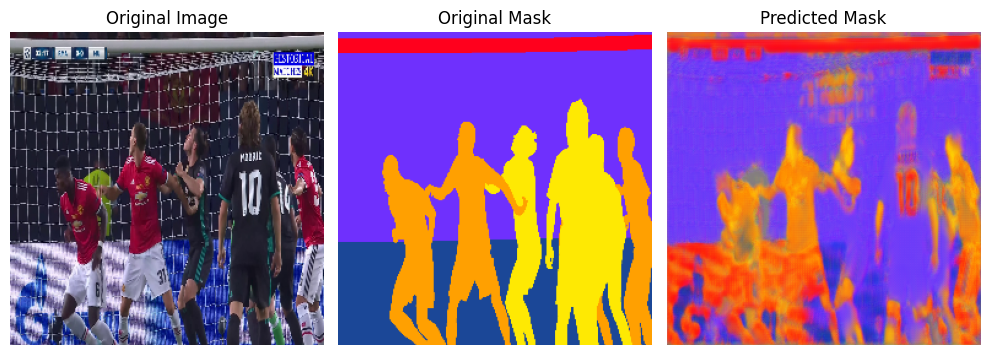

6/6 [==============================] - 8s 1s/step - loss: 0.5165 - accuracy: 0.9645 - val_loss: 0.6332 - val_accuracy: 0.8864
Epoch 42/200
6/6 [==============================] - ETA: 0s - loss: 0.5203 - accuracy: 0.9646

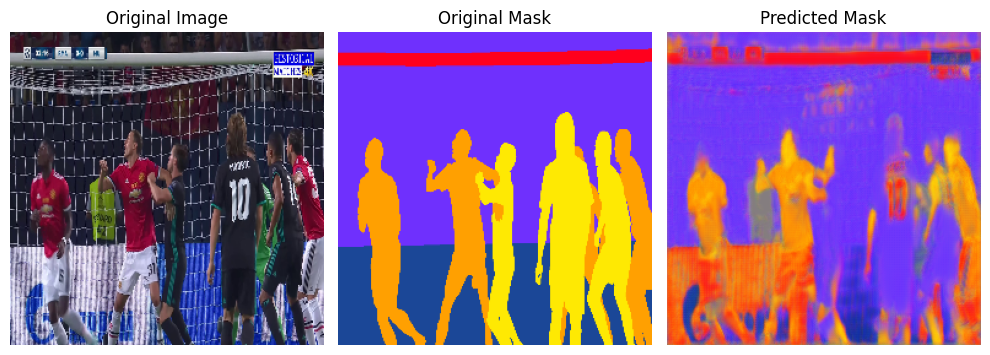

6/6 [==============================] - 8s 1s/step - loss: 0.5203 - accuracy: 0.9646 - val_loss: 0.6360 - val_accuracy: 0.8843
Epoch 43/200
6/6 [==============================] - ETA: 0s - loss: 0.5241 - accuracy: 0.9643

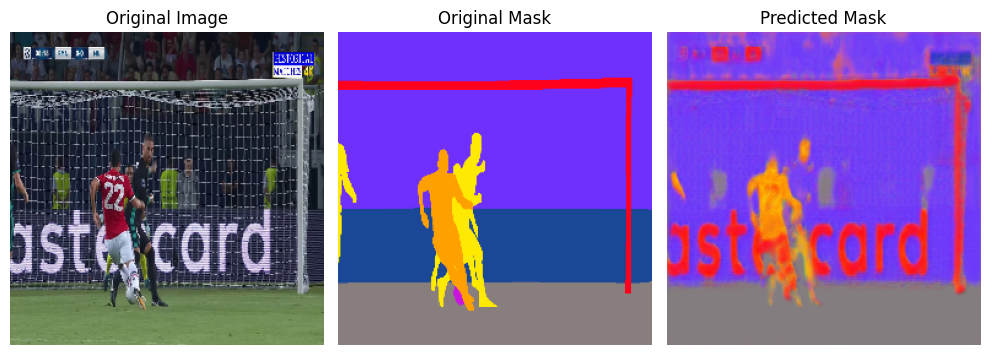

6/6 [==============================] - 8s 1s/step - loss: 0.5241 - accuracy: 0.9643 - val_loss: 0.6350 - val_accuracy: 0.8841
Epoch 44/200
6/6 [==============================] - ETA: 0s - loss: 0.5178 - accuracy: 0.9698

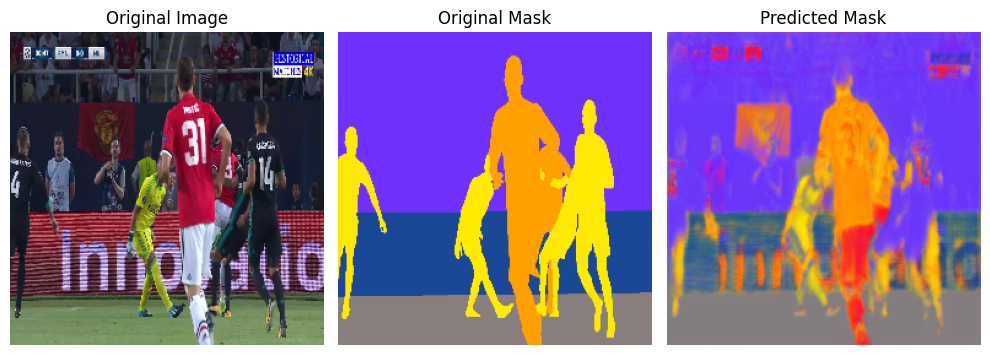

6/6 [==============================] - 8s 1s/step - loss: 0.5178 - accuracy: 0.9698 - val_loss: 0.6428 - val_accuracy: 0.8838
Epoch 45/200
6/6 [==============================] - ETA: 0s - loss: 0.5186 - accuracy: 0.9691

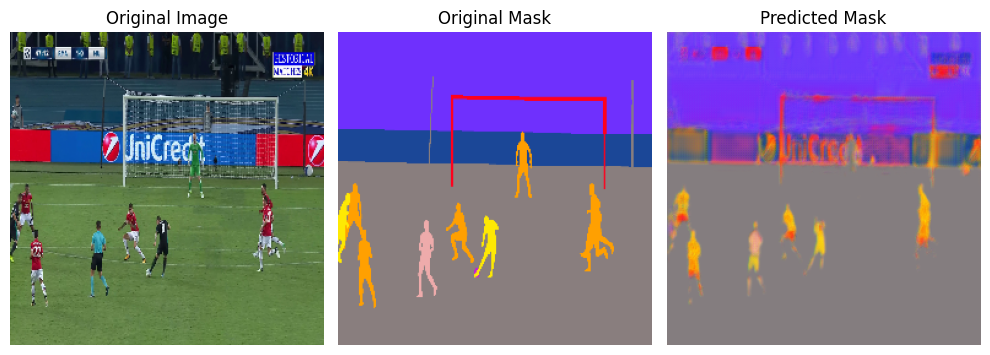

6/6 [==============================] - 8s 1s/step - loss: 0.5186 - accuracy: 0.9691 - val_loss: 0.6430 - val_accuracy: 0.8852
Epoch 46/200
6/6 [==============================] - ETA: 0s - loss: 0.5175 - accuracy: 0.9675

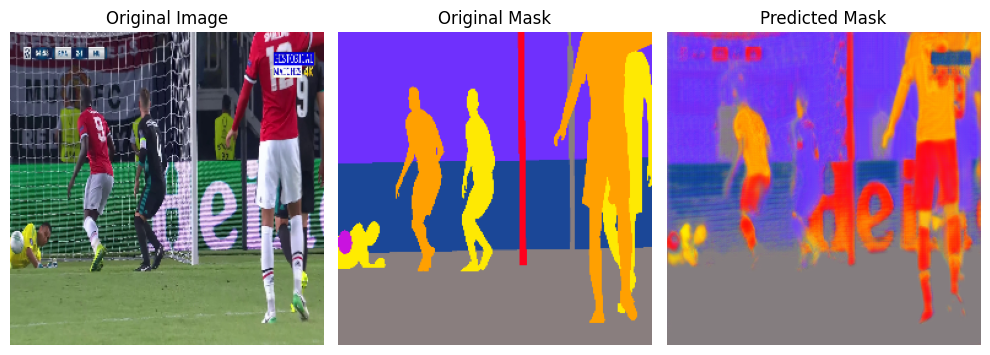

6/6 [==============================] - 8s 1s/step - loss: 0.5175 - accuracy: 0.9675 - val_loss: 0.6463 - val_accuracy: 0.8849
Epoch 47/200
6/6 [==============================] - ETA: 0s - loss: 0.5203 - accuracy: 0.9677

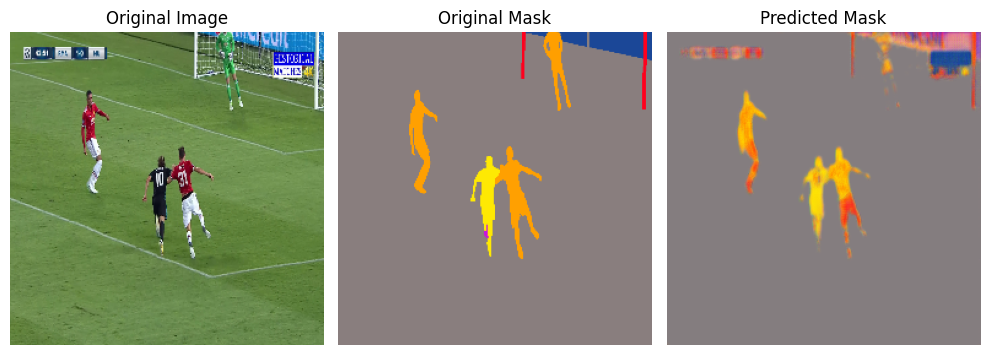

6/6 [==============================] - 8s 1s/step - loss: 0.5203 - accuracy: 0.9677 - val_loss: 0.6304 - val_accuracy: 0.8797
Epoch 48/200
6/6 [==============================] - ETA: 0s - loss: 0.5248 - accuracy: 0.9696

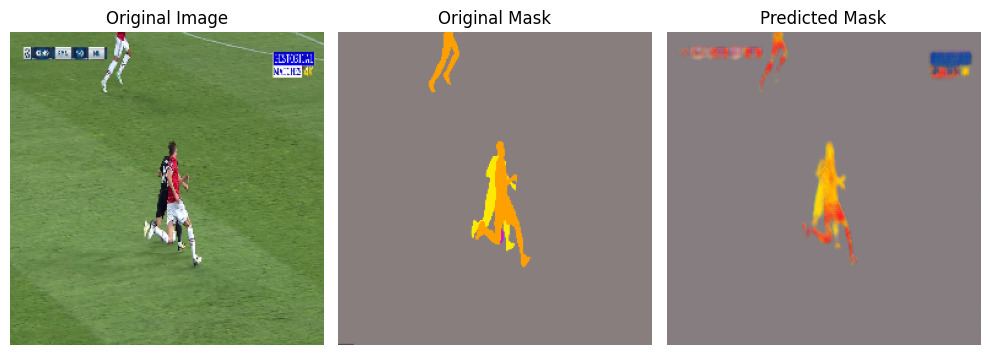

6/6 [==============================] - 14s 3s/step - loss: 0.5248 - accuracy: 0.9696 - val_loss: 0.6221 - val_accuracy: 0.9008
Epoch 49/200
6/6 [==============================] - ETA: 0s - loss: 0.5104 - accuracy: 0.9725

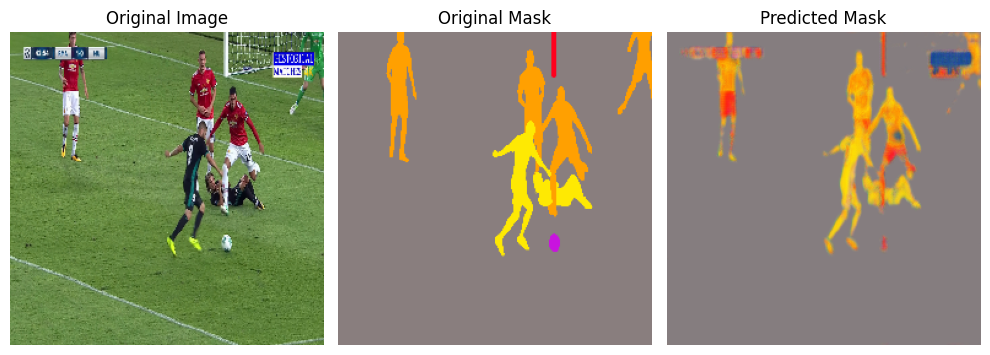

6/6 [==============================] - 8s 1s/step - loss: 0.5104 - accuracy: 0.9725 - val_loss: 0.6545 - val_accuracy: 0.8513
Epoch 50/200
6/6 [==============================] - ETA: 0s - loss: 0.5170 - accuracy: 0.9721

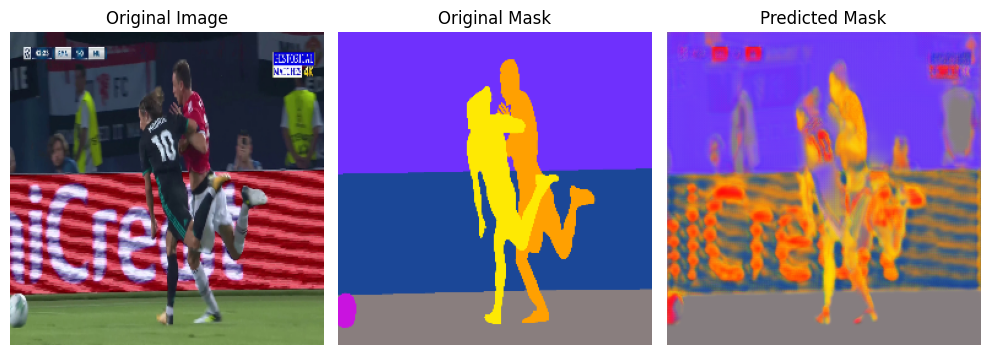

6/6 [==============================] - 8s 1s/step - loss: 0.5170 - accuracy: 0.9721 - val_loss: 0.6232 - val_accuracy: 0.8967
Epoch 51/200
6/6 [==============================] - ETA: 0s - loss: 0.5283 - accuracy: 0.9709

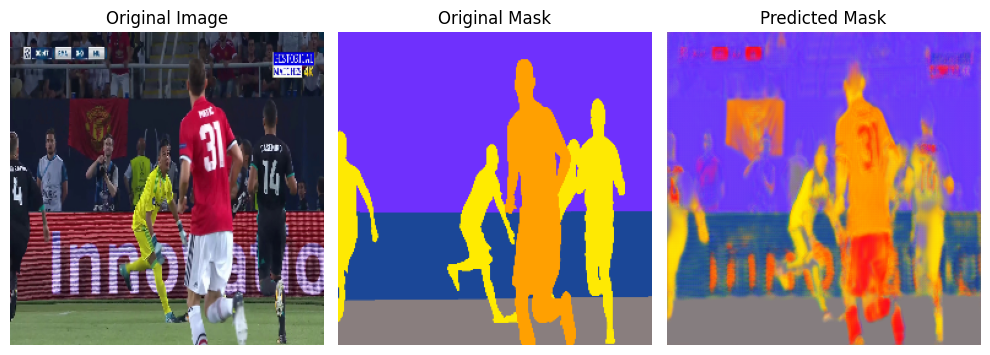

6/6 [==============================] - 8s 1s/step - loss: 0.5283 - accuracy: 0.9709 - val_loss: 0.6312 - val_accuracy: 0.9021
Epoch 52/200
6/6 [==============================] - ETA: 0s - loss: 0.5067 - accuracy: 0.9719

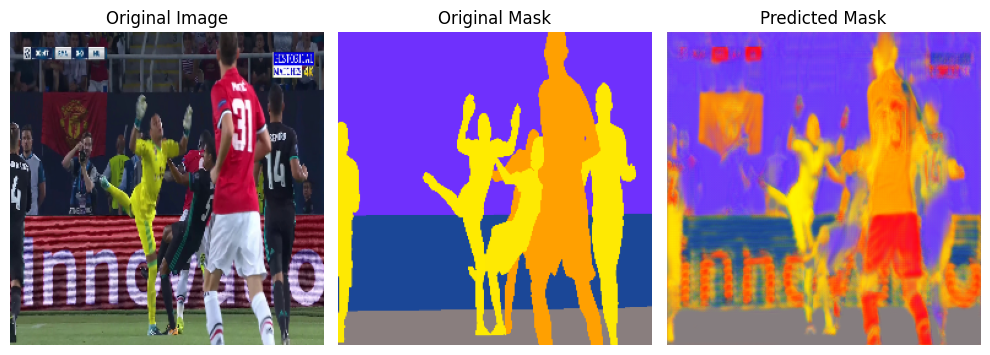

6/6 [==============================] - 9s 2s/step - loss: 0.5067 - accuracy: 0.9719 - val_loss: 0.6206 - val_accuracy: 0.8963
Epoch 53/200
6/6 [==============================] - ETA: 0s - loss: 0.5147 - accuracy: 0.9719

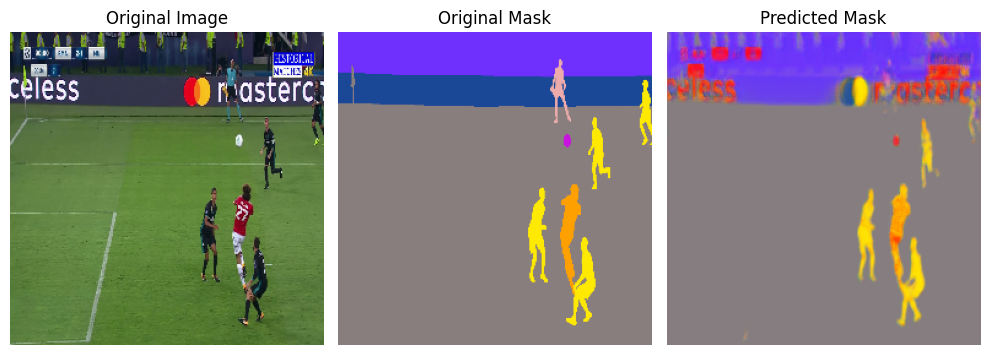

6/6 [==============================] - 8s 1s/step - loss: 0.5147 - accuracy: 0.9719 - val_loss: 0.6264 - val_accuracy: 0.9031
Epoch 54/200
6/6 [==============================] - ETA: 0s - loss: 0.5169 - accuracy: 0.9753

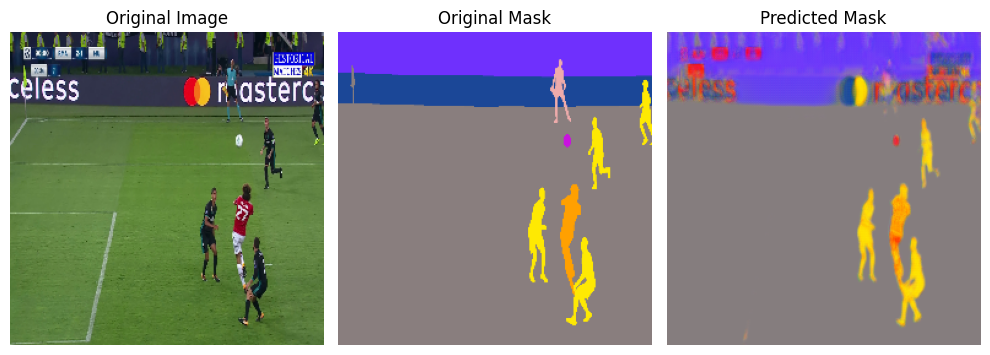

6/6 [==============================] - 9s 2s/step - loss: 0.5169 - accuracy: 0.9753 - val_loss: 0.6069 - val_accuracy: 0.9164
Epoch 55/200
6/6 [==============================] - ETA: 0s - loss: 0.5133 - accuracy: 0.9746

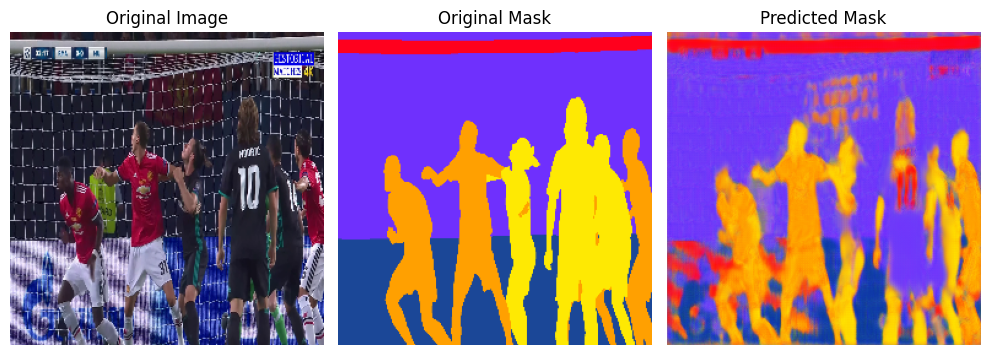

6/6 [==============================] - 9s 2s/step - loss: 0.5133 - accuracy: 0.9746 - val_loss: 0.5942 - val_accuracy: 0.9226
Epoch 56/200
6/6 [==============================] - ETA: 0s - loss: 0.5147 - accuracy: 0.9750

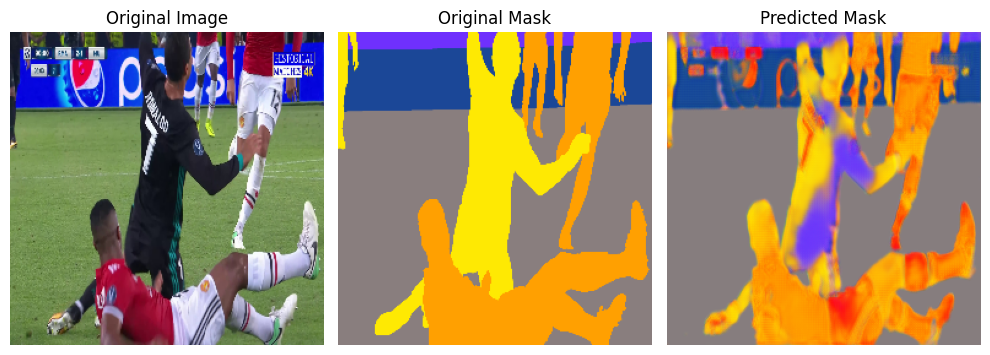

6/6 [==============================] - 8s 1s/step - loss: 0.5147 - accuracy: 0.9750 - val_loss: 0.6088 - val_accuracy: 0.9176
Epoch 57/200
6/6 [==============================] - ETA: 0s - loss: 0.5104 - accuracy: 0.9759

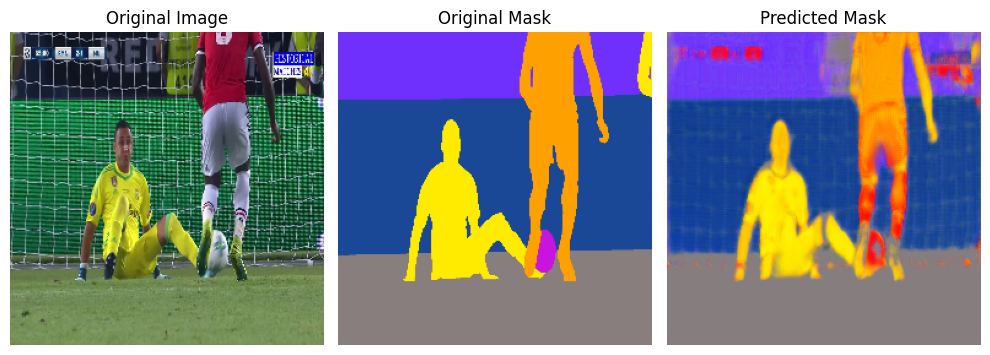

6/6 [==============================] - 8s 1s/step - loss: 0.5104 - accuracy: 0.9759 - val_loss: 0.6129 - val_accuracy: 0.9164
Epoch 58/200
6/6 [==============================] - ETA: 0s - loss: 0.5187 - accuracy: 0.9746

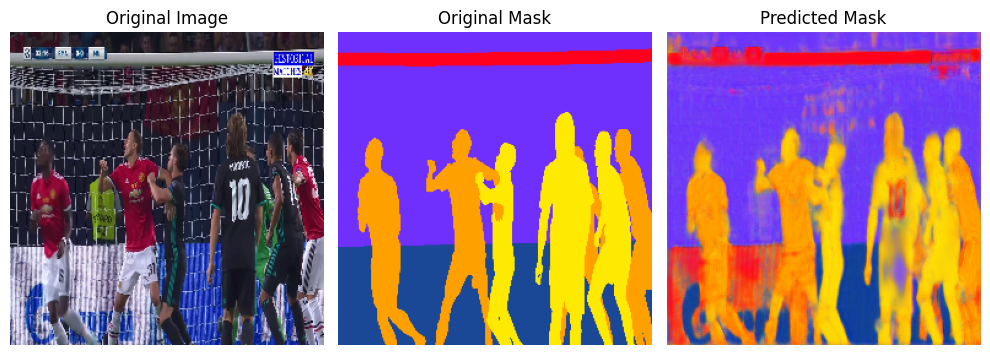

6/6 [==============================] - 10s 2s/step - loss: 0.5187 - accuracy: 0.9746 - val_loss: 0.5926 - val_accuracy: 0.9264
Epoch 59/200
6/6 [==============================] - ETA: 0s - loss: 0.5113 - accuracy: 0.9759

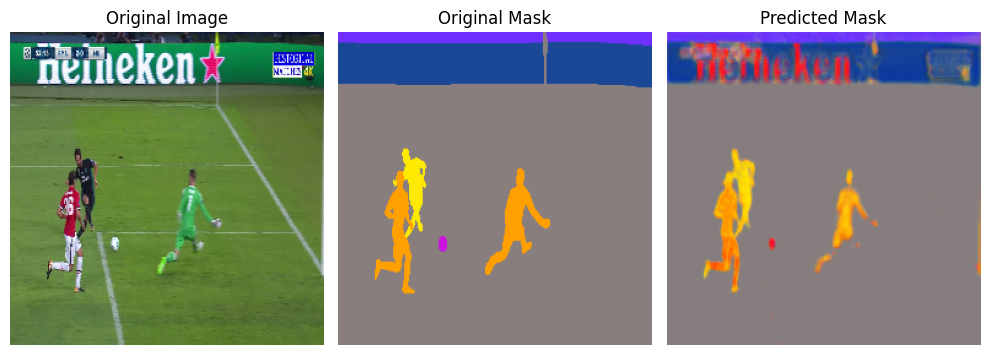

6/6 [==============================] - 8s 1s/step - loss: 0.5113 - accuracy: 0.9759 - val_loss: 0.6047 - val_accuracy: 0.9153
Epoch 60/200
6/6 [==============================] - ETA: 0s - loss: 0.5142 - accuracy: 0.9769

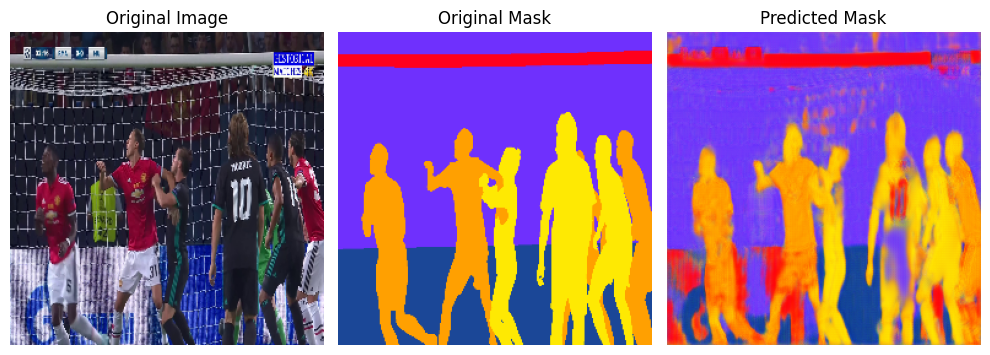

6/6 [==============================] - 8s 1s/step - loss: 0.5142 - accuracy: 0.9769 - val_loss: 0.5928 - val_accuracy: 0.9275
Epoch 61/200
6/6 [==============================] - ETA: 0s - loss: 0.5116 - accuracy: 0.9770

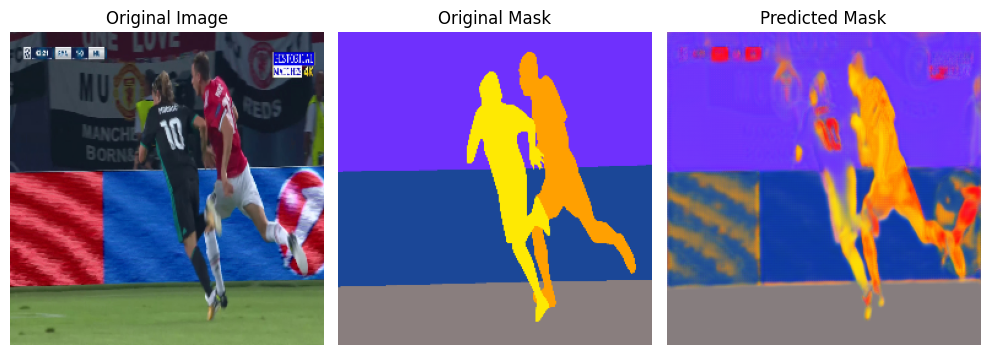

6/6 [==============================] - 9s 2s/step - loss: 0.5116 - accuracy: 0.9770 - val_loss: 0.5875 - val_accuracy: 0.9294
Epoch 62/200
6/6 [==============================] - ETA: 0s - loss: 0.5278 - accuracy: 0.9769

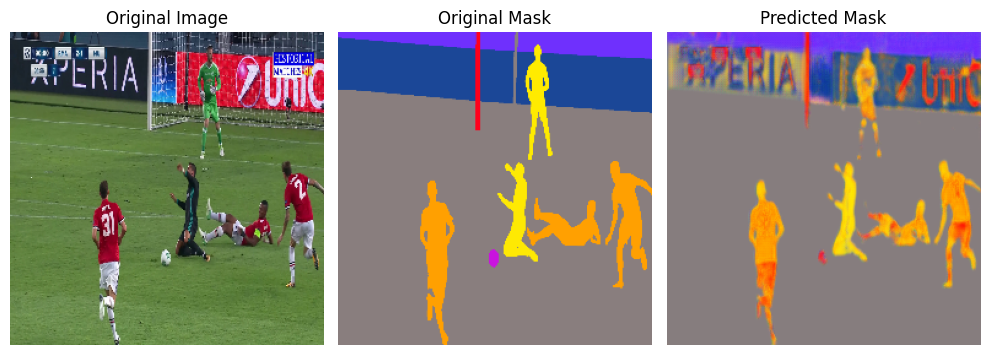

6/6 [==============================] - 8s 1s/step - loss: 0.5278 - accuracy: 0.9769 - val_loss: 0.5978 - val_accuracy: 0.9240
Epoch 63/200
6/6 [==============================] - ETA: 0s - loss: 0.5005 - accuracy: 0.9792

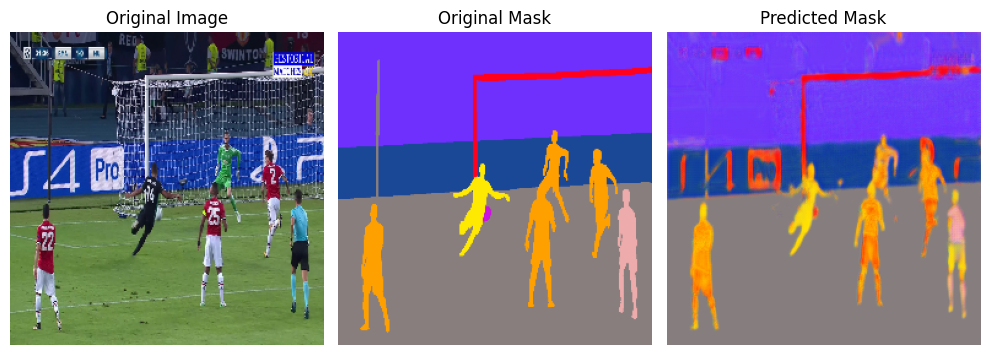

6/6 [==============================] - 8s 1s/step - loss: 0.5005 - accuracy: 0.9792 - val_loss: 0.5937 - val_accuracy: 0.9300
Epoch 64/200
6/6 [==============================] - ETA: 0s - loss: 0.5142 - accuracy: 0.9771

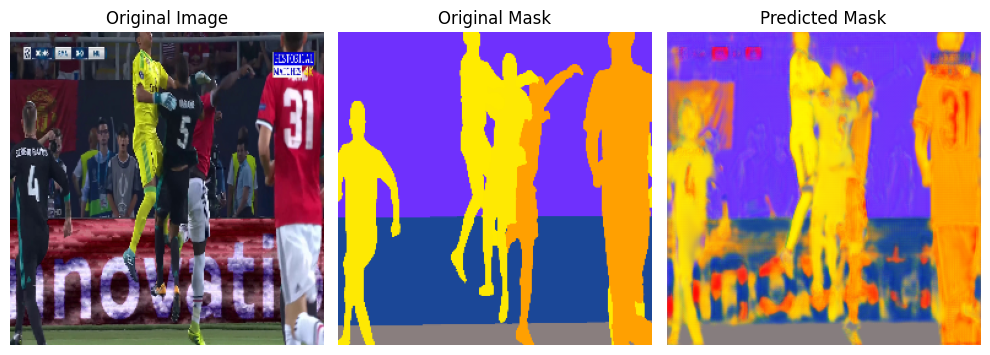

6/6 [==============================] - 9s 2s/step - loss: 0.5142 - accuracy: 0.9771 - val_loss: 0.5829 - val_accuracy: 0.9327
Epoch 65/200
6/6 [==============================] - ETA: 0s - loss: 0.5090 - accuracy: 0.9772

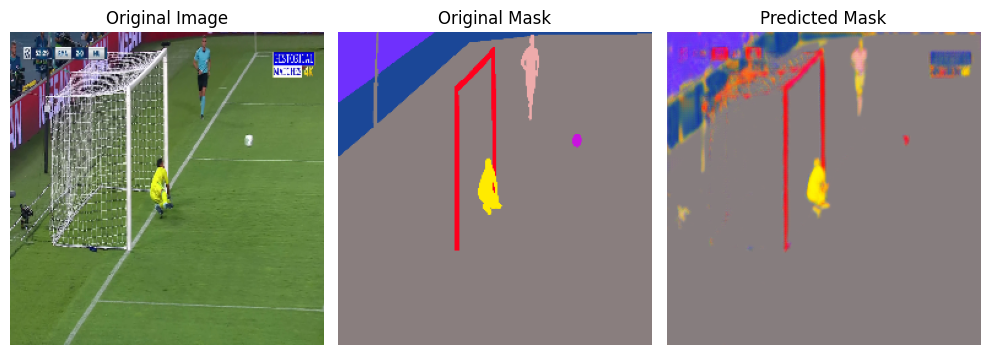

6/6 [==============================] - 9s 2s/step - loss: 0.5090 - accuracy: 0.9772 - val_loss: 0.5799 - val_accuracy: 0.9345
Epoch 66/200
6/6 [==============================] - ETA: 0s - loss: 0.5132 - accuracy: 0.9777

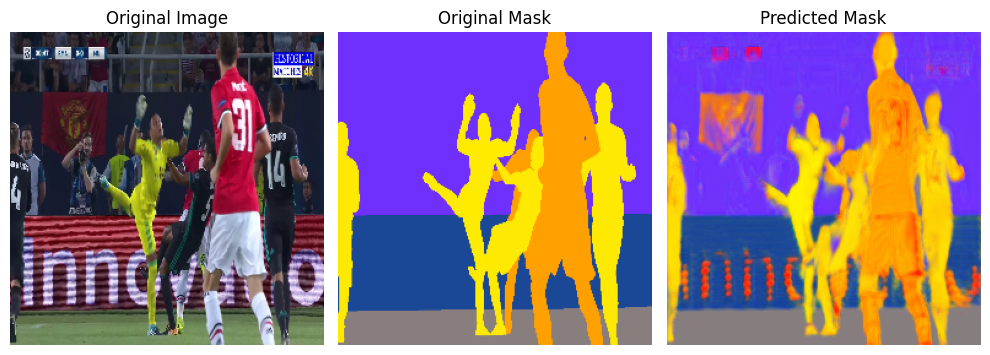

6/6 [==============================] - 9s 2s/step - loss: 0.5132 - accuracy: 0.9777 - val_loss: 0.5765 - val_accuracy: 0.9388
Epoch 67/200
6/6 [==============================] - ETA: 0s - loss: 0.5092 - accuracy: 0.9776

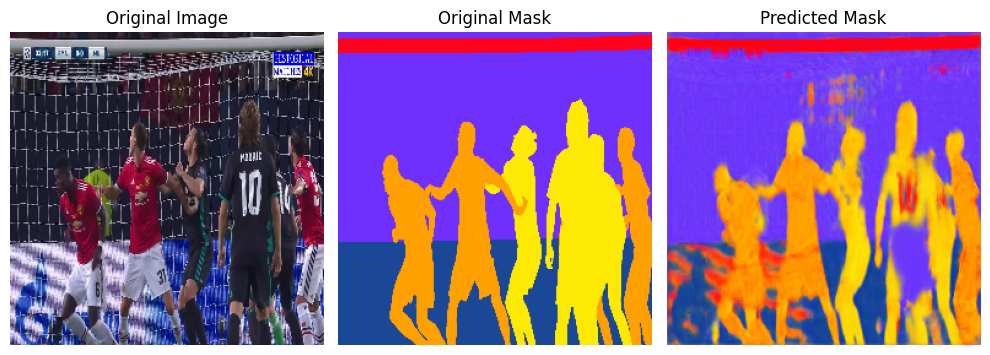

6/6 [==============================] - 9s 2s/step - loss: 0.5092 - accuracy: 0.9776 - val_loss: 0.5740 - val_accuracy: 0.9415
Epoch 68/200
6/6 [==============================] - ETA: 0s - loss: 0.5131 - accuracy: 0.9797

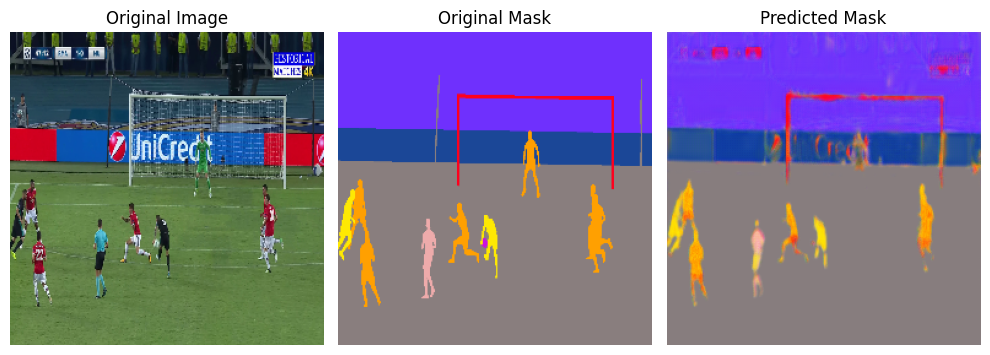

6/6 [==============================] - 9s 2s/step - loss: 0.5131 - accuracy: 0.9797 - val_loss: 0.5726 - val_accuracy: 0.9439
Epoch 69/200
6/6 [==============================] - ETA: 0s - loss: 0.5053 - accuracy: 0.9784

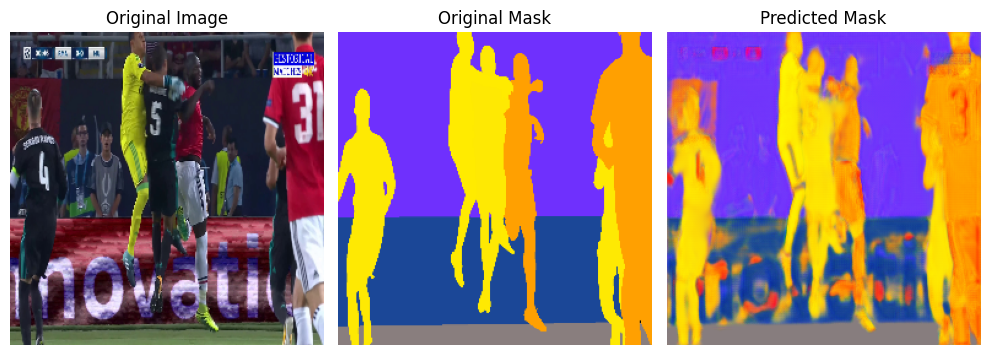

6/6 [==============================] - 9s 2s/step - loss: 0.5053 - accuracy: 0.9784 - val_loss: 0.5646 - val_accuracy: 0.9455
Epoch 70/200
6/6 [==============================] - ETA: 0s - loss: 0.5177 - accuracy: 0.9781

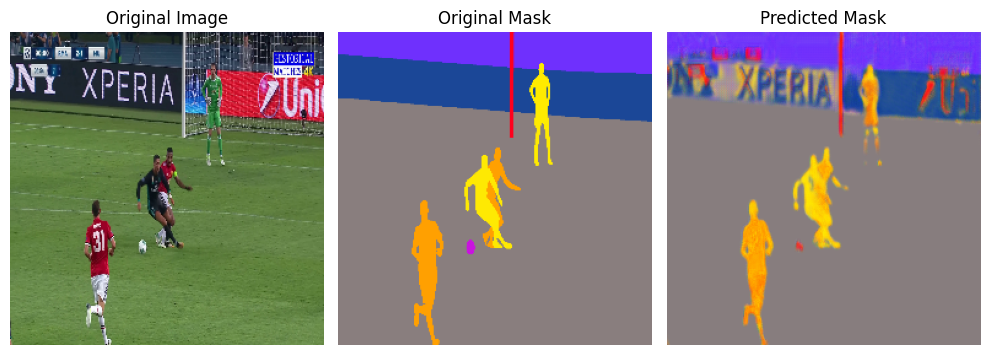

6/6 [==============================] - 8s 1s/step - loss: 0.5177 - accuracy: 0.9781 - val_loss: 0.5749 - val_accuracy: 0.9412
Epoch 71/200
6/6 [==============================] - ETA: 0s - loss: 0.5135 - accuracy: 0.9801

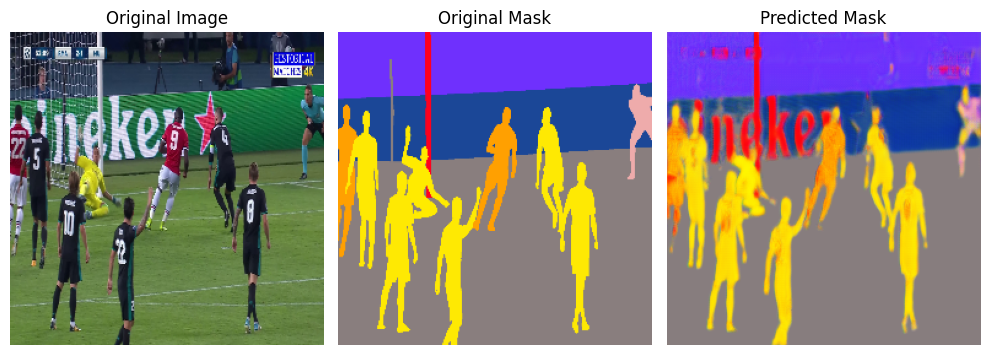

6/6 [==============================] - 8s 1s/step - loss: 0.5135 - accuracy: 0.9801 - val_loss: 0.5810 - val_accuracy: 0.9385
Epoch 72/200
6/6 [==============================] - ETA: 0s - loss: 0.5118 - accuracy: 0.9777

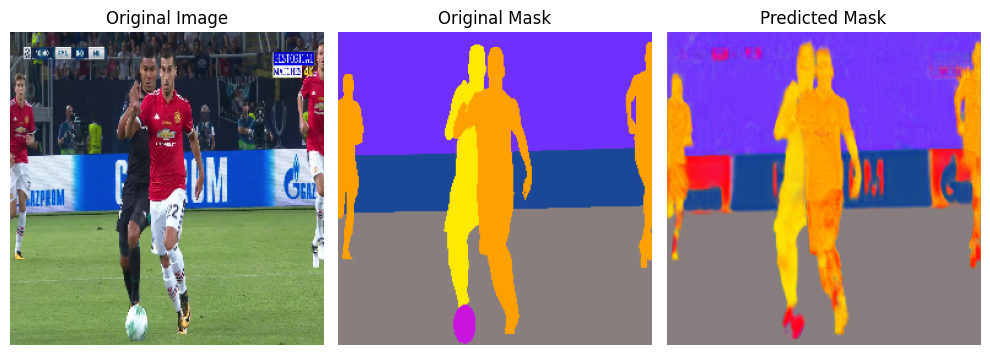

6/6 [==============================] - 8s 1s/step - loss: 0.5118 - accuracy: 0.9777 - val_loss: 0.5686 - val_accuracy: 0.9465
Epoch 73/200
6/6 [==============================] - ETA: 0s - loss: 0.5007 - accuracy: 0.9804

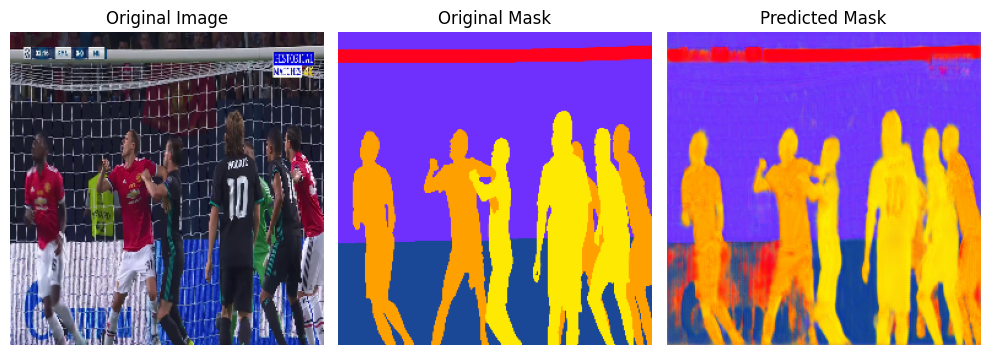

6/6 [==============================] - 8s 1s/step - loss: 0.5007 - accuracy: 0.9804 - val_loss: 0.5746 - val_accuracy: 0.9443
Epoch 74/200
6/6 [==============================] - ETA: 0s - loss: 0.5186 - accuracy: 0.9776

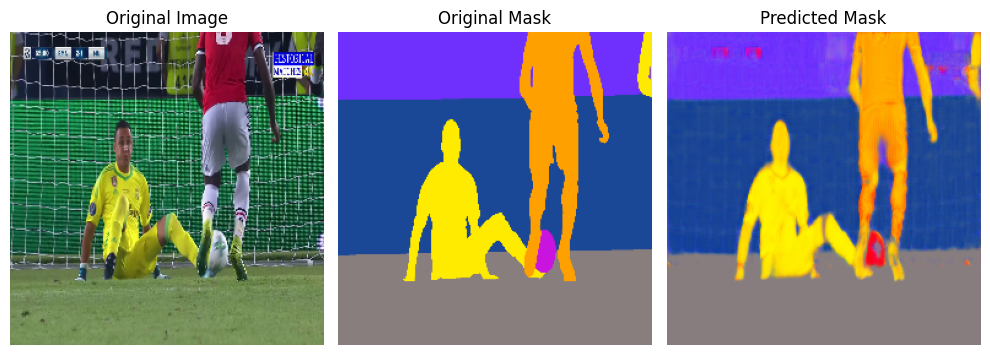

6/6 [==============================] - 14s 3s/step - loss: 0.5186 - accuracy: 0.9776 - val_loss: 0.5591 - val_accuracy: 0.9554
Epoch 75/200
6/6 [==============================] - ETA: 0s - loss: 0.5107 - accuracy: 0.9810

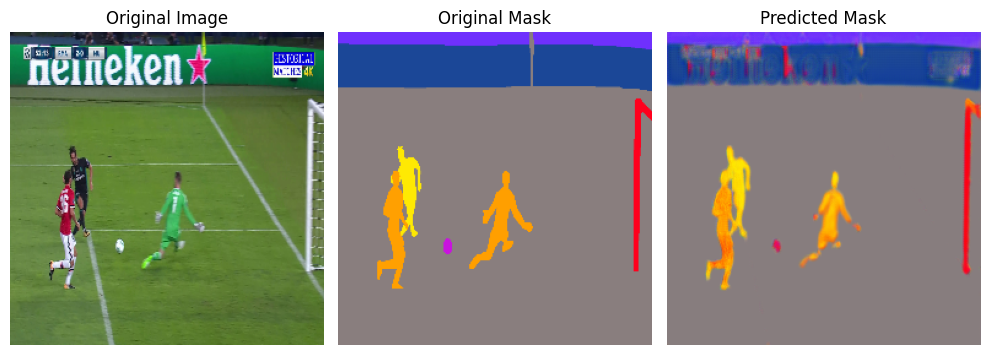

6/6 [==============================] - 8s 1s/step - loss: 0.5107 - accuracy: 0.9810 - val_loss: 0.5595 - val_accuracy: 0.9543
Epoch 76/200
6/6 [==============================] - ETA: 0s - loss: 0.5105 - accuracy: 0.9791

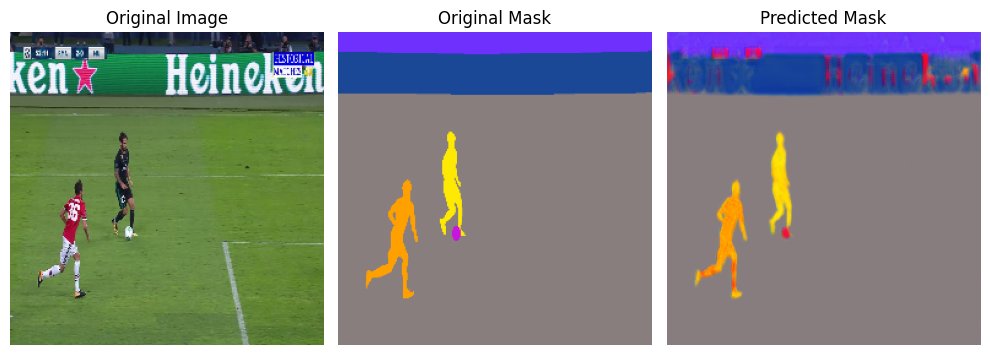

6/6 [==============================] - 8s 1s/step - loss: 0.5105 - accuracy: 0.9791 - val_loss: 0.5662 - val_accuracy: 0.9523
Epoch 77/200
6/6 [==============================] - ETA: 0s - loss: 0.5137 - accuracy: 0.9803

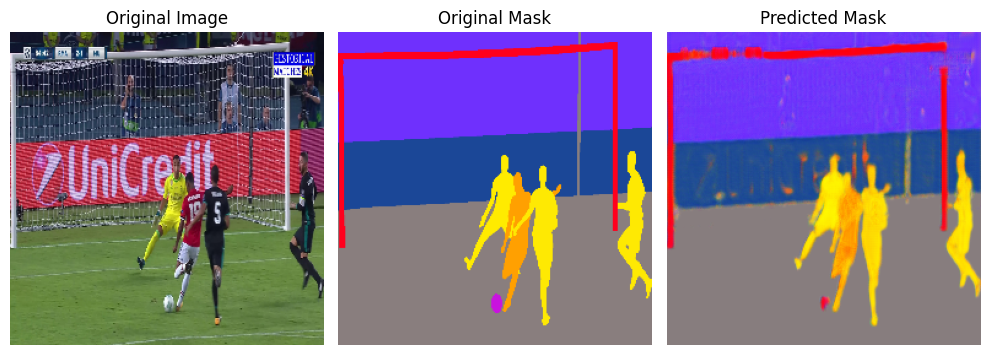

6/6 [==============================] - 8s 1s/step - loss: 0.5137 - accuracy: 0.9803 - val_loss: 0.5595 - val_accuracy: 0.9555
Epoch 78/200
6/6 [==============================] - ETA: 0s - loss: 0.5077 - accuracy: 0.9816

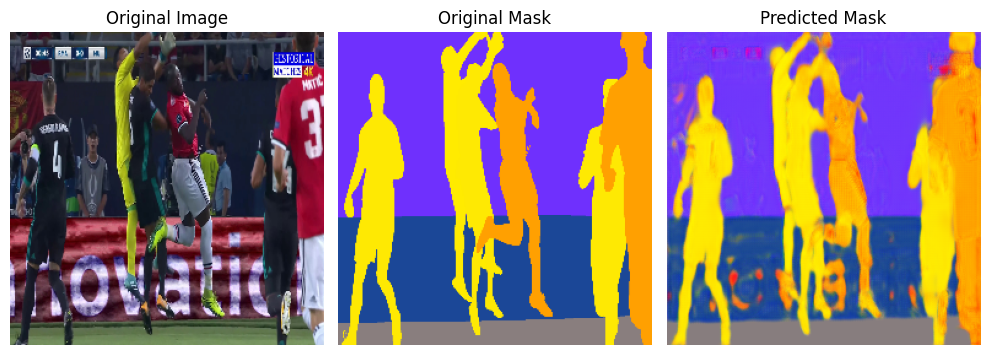

6/6 [==============================] - 8s 1s/step - loss: 0.5077 - accuracy: 0.9816 - val_loss: 0.5630 - val_accuracy: 0.9536
Epoch 79/200
6/6 [==============================] - ETA: 0s - loss: 0.5038 - accuracy: 0.9775

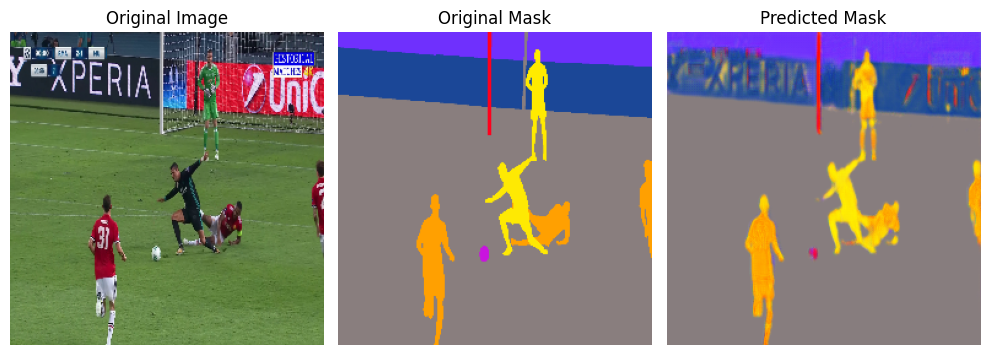

6/6 [==============================] - 8s 1s/step - loss: 0.5038 - accuracy: 0.9775 - val_loss: 0.5620 - val_accuracy: 0.9566
Epoch 80/200
6/6 [==============================] - ETA: 0s - loss: 0.5162 - accuracy: 0.9794

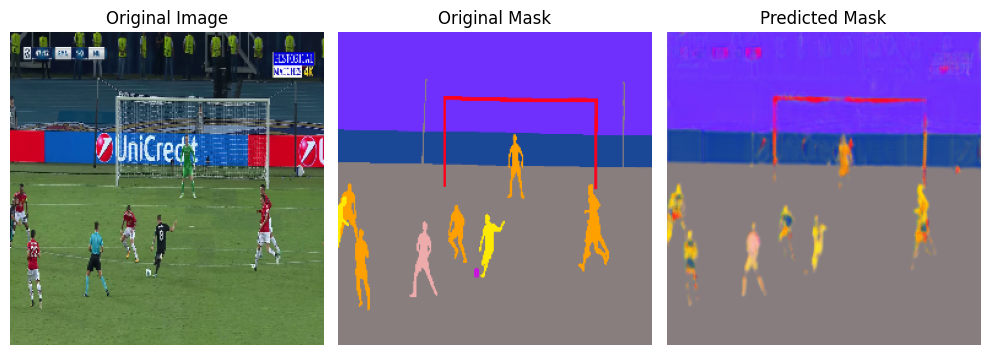

6/6 [==============================] - 8s 1s/step - loss: 0.5162 - accuracy: 0.9794 - val_loss: 0.5601 - val_accuracy: 0.9605
Epoch 81/200
6/6 [==============================] - ETA: 0s - loss: 0.5113 - accuracy: 0.9804

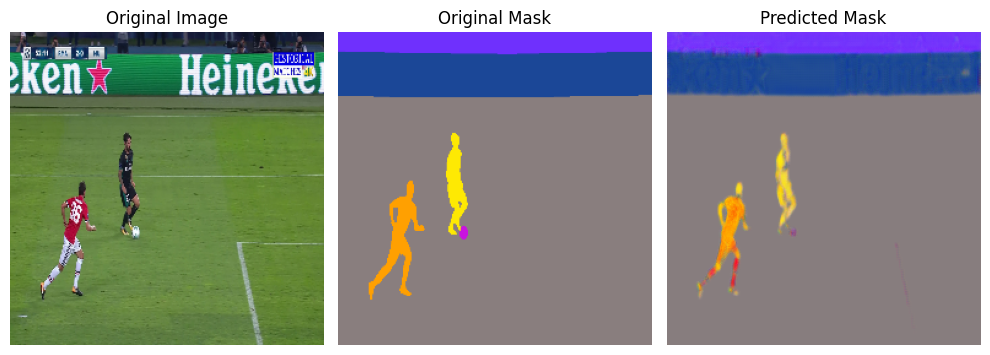

6/6 [==============================] - 13s 2s/step - loss: 0.5113 - accuracy: 0.9804 - val_loss: 0.5457 - val_accuracy: 0.9713
Epoch 82/200
6/6 [==============================] - ETA: 0s - loss: 0.5116 - accuracy: 0.9823

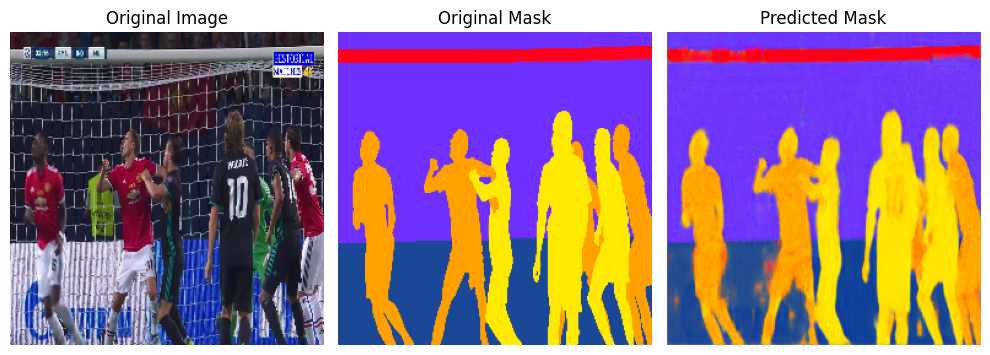

6/6 [==============================] - 8s 1s/step - loss: 0.5116 - accuracy: 0.9823 - val_loss: 0.5466 - val_accuracy: 0.9682
Epoch 83/200
6/6 [==============================] - ETA: 0s - loss: 0.5040 - accuracy: 0.9818

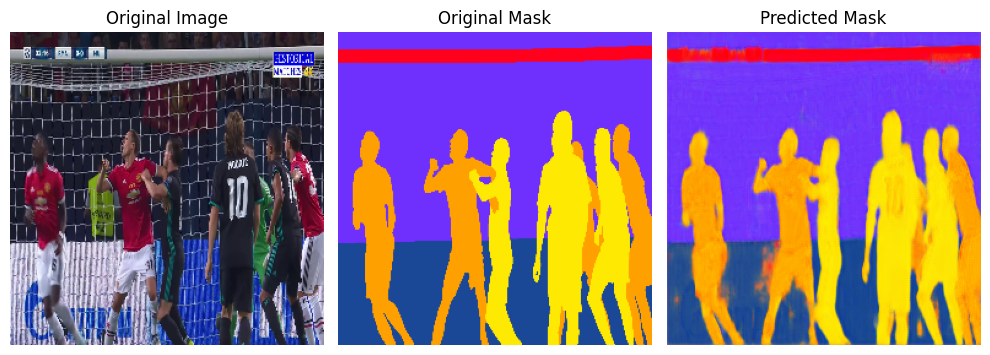

6/6 [==============================] - 8s 1s/step - loss: 0.5040 - accuracy: 0.9818 - val_loss: 0.5549 - val_accuracy: 0.9615
Epoch 84/200
6/6 [==============================] - ETA: 0s - loss: 0.5165 - accuracy: 0.9813

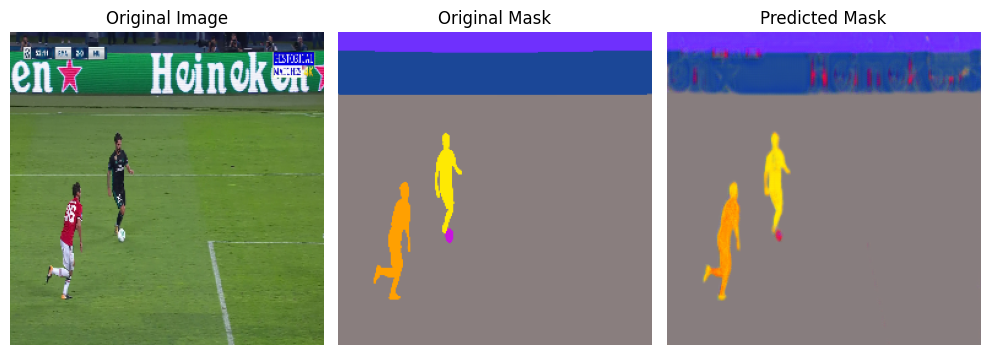

6/6 [==============================] - 8s 1s/step - loss: 0.5165 - accuracy: 0.9813 - val_loss: 0.5532 - val_accuracy: 0.9620
Epoch 85/200
6/6 [==============================] - ETA: 0s - loss: 0.5061 - accuracy: 0.9818

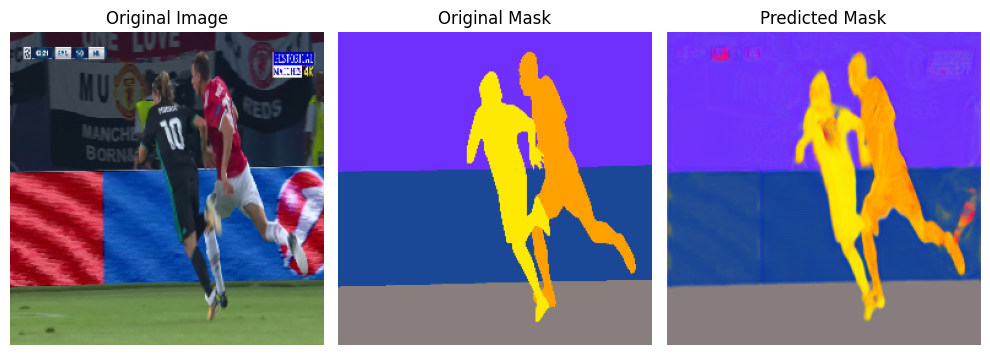

6/6 [==============================] - 9s 2s/step - loss: 0.5061 - accuracy: 0.9818 - val_loss: 0.5432 - val_accuracy: 0.9673
Epoch 86/200
6/6 [==============================] - ETA: 0s - loss: 0.5110 - accuracy: 0.9818

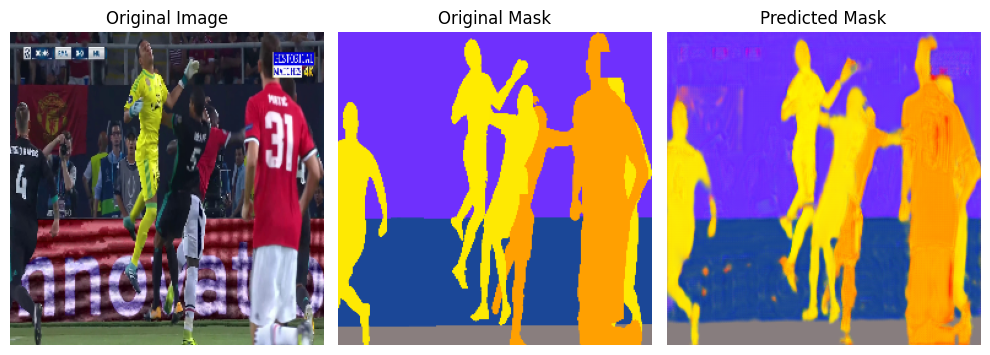

6/6 [==============================] - 8s 1s/step - loss: 0.5110 - accuracy: 0.9818 - val_loss: 0.5581 - val_accuracy: 0.9571
Epoch 87/200
6/6 [==============================] - ETA: 0s - loss: 0.5071 - accuracy: 0.9832

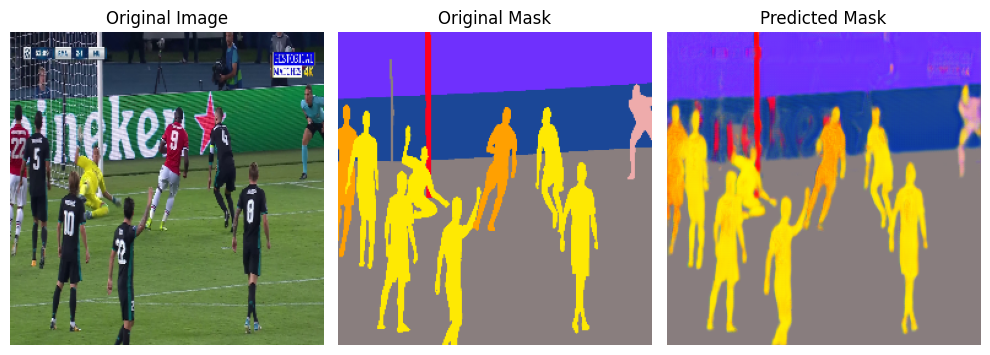

6/6 [==============================] - 8s 1s/step - loss: 0.5071 - accuracy: 0.9832 - val_loss: 0.5461 - val_accuracy: 0.9662
Epoch 88/200
6/6 [==============================] - ETA: 0s - loss: 0.5137 - accuracy: 0.9812

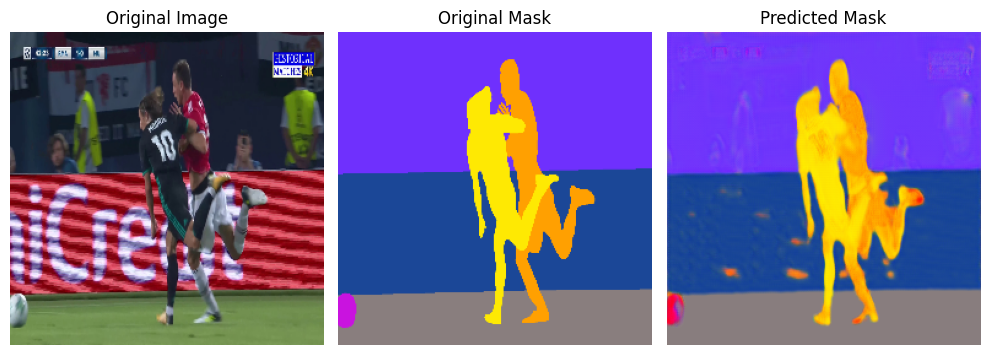

6/6 [==============================] - 8s 1s/step - loss: 0.5137 - accuracy: 0.9812 - val_loss: 0.5452 - val_accuracy: 0.9636
Epoch 89/200
6/6 [==============================] - ETA: 0s - loss: 0.5068 - accuracy: 0.9804

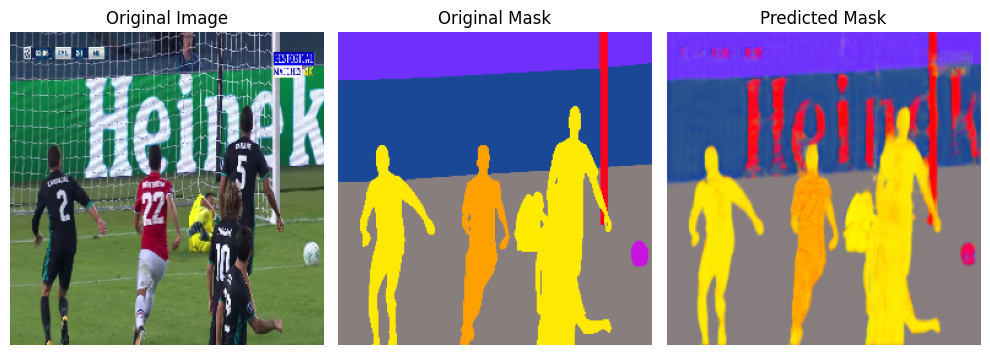

6/6 [==============================] - 8s 1s/step - loss: 0.5068 - accuracy: 0.9804 - val_loss: 0.5553 - val_accuracy: 0.9577
Epoch 90/200
6/6 [==============================] - ETA: 0s - loss: 0.5086 - accuracy: 0.9826

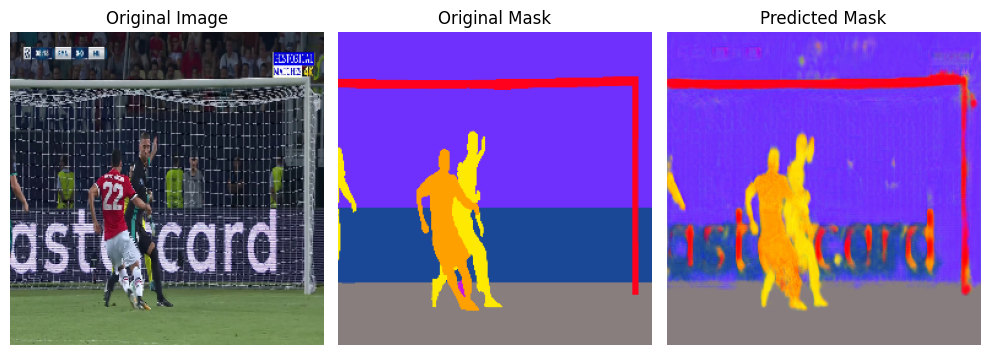

6/6 [==============================] - 8s 1s/step - loss: 0.5086 - accuracy: 0.9826 - val_loss: 0.5476 - val_accuracy: 0.9648
Epoch 91/200
6/6 [==============================] - ETA: 0s - loss: 0.5148 - accuracy: 0.9809

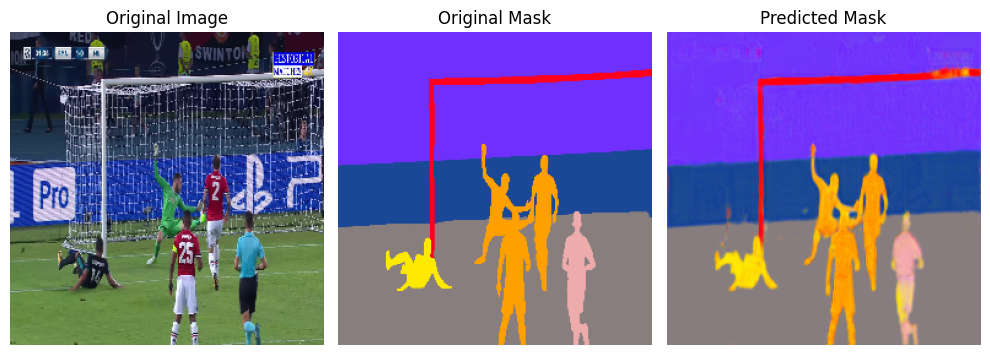

6/6 [==============================] - 9s 2s/step - loss: 0.5148 - accuracy: 0.9809 - val_loss: 0.5398 - val_accuracy: 0.9716
Epoch 92/200
6/6 [==============================] - ETA: 0s - loss: 0.4970 - accuracy: 0.9822

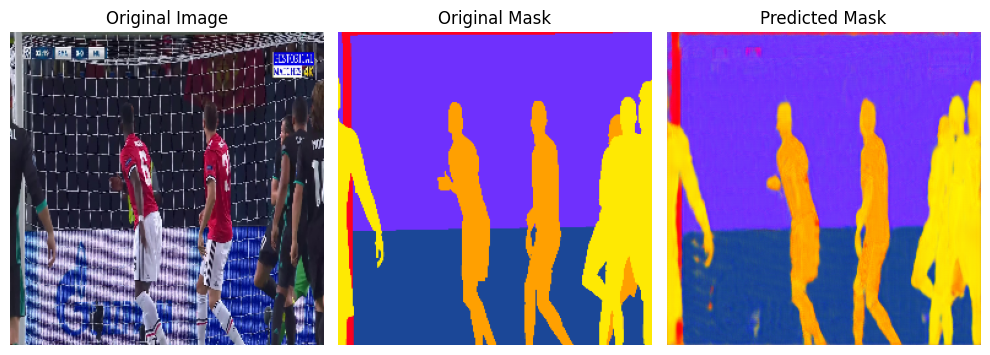

6/6 [==============================] - 8s 1s/step - loss: 0.4970 - accuracy: 0.9822 - val_loss: 0.5504 - val_accuracy: 0.9619
Epoch 93/200
6/6 [==============================] - ETA: 0s - loss: 0.5195 - accuracy: 0.9813

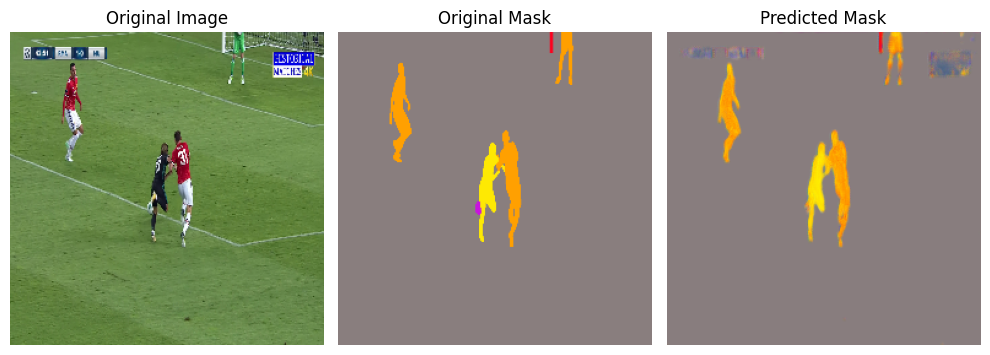

6/6 [==============================] - 8s 1s/step - loss: 0.5195 - accuracy: 0.9813 - val_loss: 0.5442 - val_accuracy: 0.9664
Epoch 94/200
6/6 [==============================] - ETA: 0s - loss: 0.5108 - accuracy: 0.9812

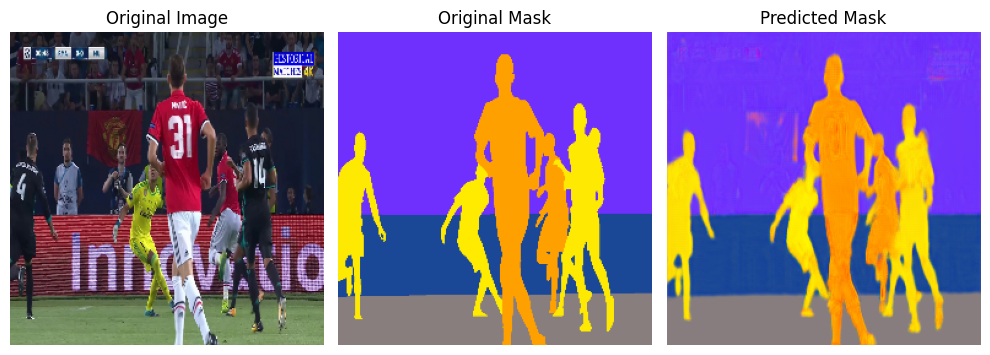

6/6 [==============================] - 8s 1s/step - loss: 0.5108 - accuracy: 0.9812 - val_loss: 0.5478 - val_accuracy: 0.9655
Epoch 95/200
6/6 [==============================] - ETA: 0s - loss: 0.5032 - accuracy: 0.9827

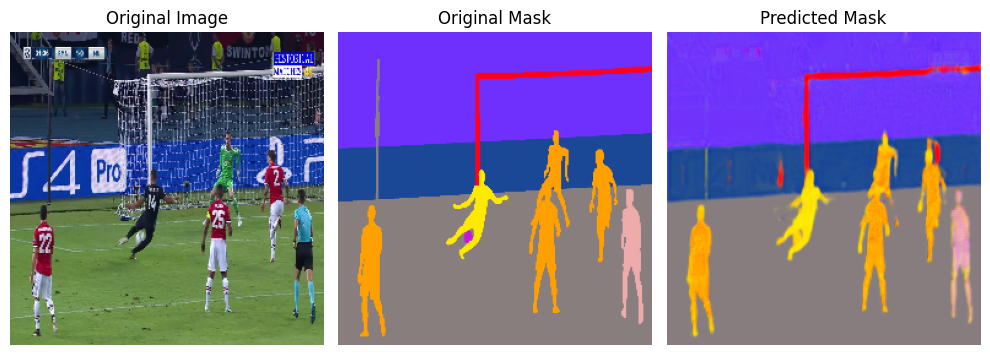

6/6 [==============================] - 8s 1s/step - loss: 0.5032 - accuracy: 0.9827 - val_loss: 0.5532 - val_accuracy: 0.9641
Epoch 96/200
6/6 [==============================] - ETA: 0s - loss: 0.5112 - accuracy: 0.9831

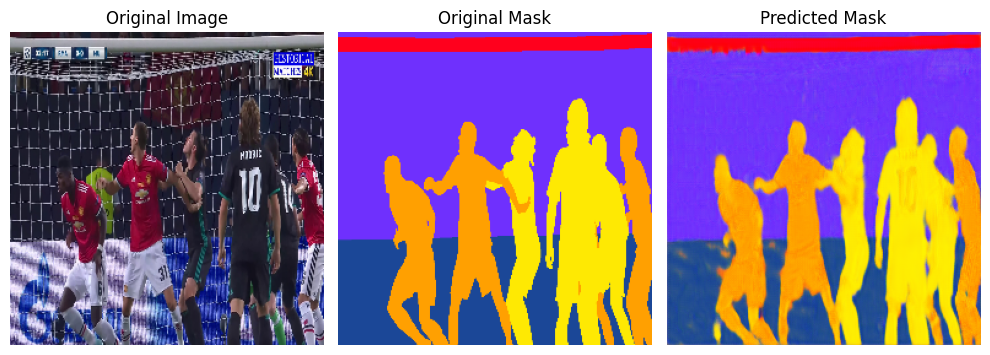

6/6 [==============================] - 14s 3s/step - loss: 0.5112 - accuracy: 0.9831 - val_loss: 0.5395 - val_accuracy: 0.9714
Epoch 97/200
6/6 [==============================] - ETA: 0s - loss: 0.5098 - accuracy: 0.9841

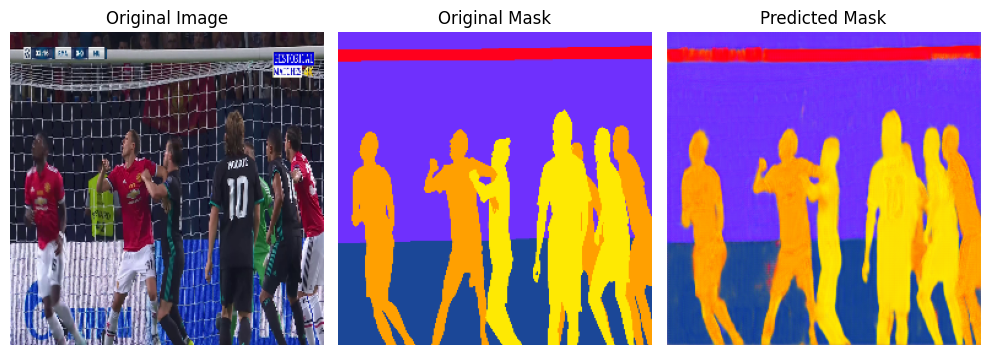

6/6 [==============================] - 8s 1s/step - loss: 0.5098 - accuracy: 0.9841 - val_loss: 0.5444 - val_accuracy: 0.9702
Epoch 98/200
6/6 [==============================] - ETA: 0s - loss: 0.5004 - accuracy: 0.9834

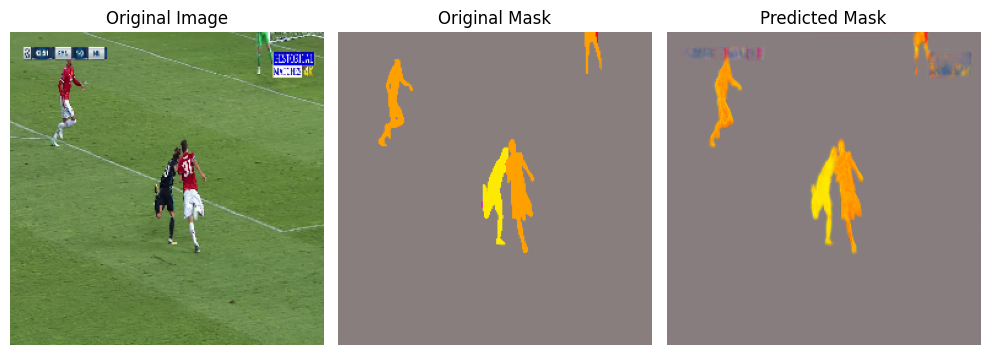

6/6 [==============================] - 8s 1s/step - loss: 0.5004 - accuracy: 0.9834 - val_loss: 0.5452 - val_accuracy: 0.9694
Epoch 99/200
6/6 [==============================] - ETA: 0s - loss: 0.5126 - accuracy: 0.9834

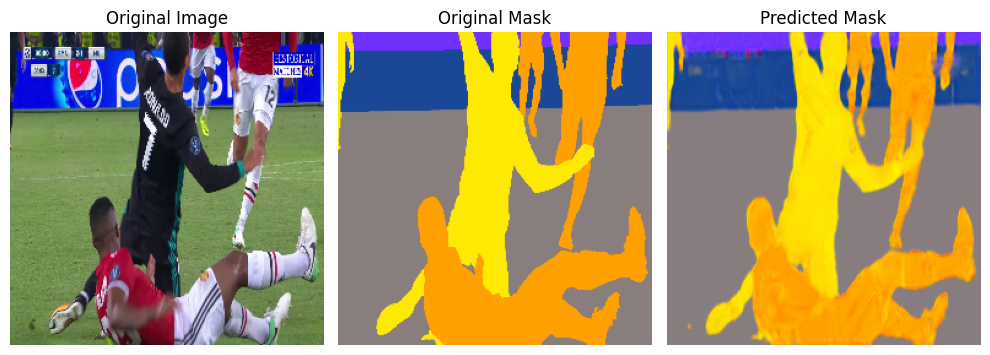

6/6 [==============================] - 8s 1s/step - loss: 0.5126 - accuracy: 0.9834 - val_loss: 0.5433 - val_accuracy: 0.9702
Epoch 100/200
6/6 [==============================] - ETA: 0s - loss: 0.5053 - accuracy: 0.9831

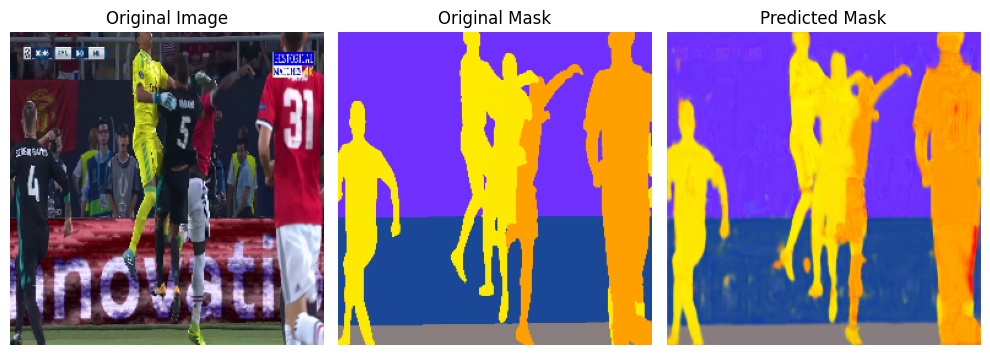

6/6 [==============================] - 8s 1s/step - loss: 0.5053 - accuracy: 0.9831 - val_loss: 0.5485 - val_accuracy: 0.9666
Epoch 101/200
6/6 [==============================] - ETA: 0s - loss: 0.5053 - accuracy: 0.9839

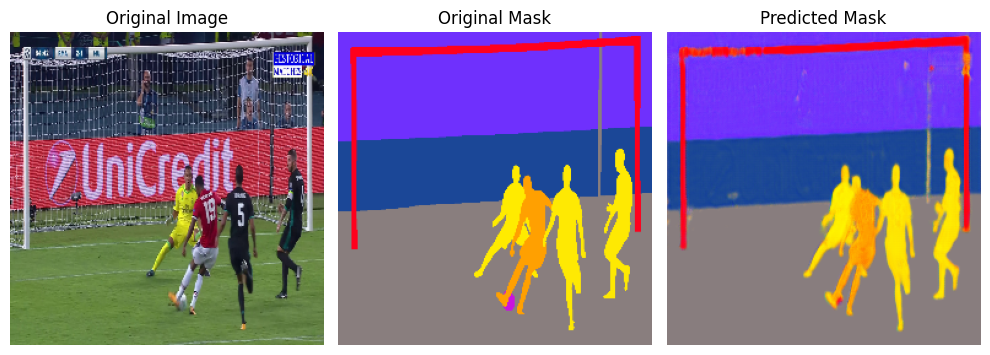

6/6 [==============================] - 8s 1s/step - loss: 0.5053 - accuracy: 0.9839 - val_loss: 0.5452 - val_accuracy: 0.9697


In [38]:
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

model.fit(
    images, labels,
    validation_split=0.2,
    epochs=200,
    batch_size=BATCH_SIZE,
    steps_per_epoch=SPE,
    callbacks=cbs
)



# ***Accuracy = 98.3***





# ***Loading Model***

In [55]:
model = keras.models.load_model('/content/UNet-Footbal-Player-Segmentation.h5', compile=False)

# ***Prediction***

1/1 [==============================] - 0s 19ms/step


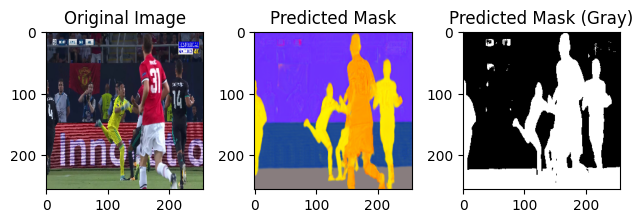

In [62]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow import keras
import cv2
img = '/content/Frame.jpg'
img =load_image(img)
new_image = np.expand_dims(img, axis=0)
prediction = model.predict(new_image)

threshold = 0.5
binary_prediction = (prediction > threshold).astype(np.uint8)

plt.subplot(1, 3, 1)
plt.imshow(new_image[0])
plt.title('Original Image')

plt.subplot(1, 3, 2)
plt.imshow(prediction[0])
plt.title('Predicted Mask')

plt.subplot(1, 3, 3)
plt.imshow(binary_prediction[0][:, :, 0], cmap='gray')
plt.title('Predicted Mask (Gray)')

plt.tight_layout()
plt.show()
